In [1]:
# This is the import cell
import sys
import os
import math
import numpy as np
import pandas as pd

first = True
pd.set_option('display.max_columns', None)
pd.set_option("display.max_rows", 10)

In [4]:
# Get the current path
if first:
    parent = os.getcwd()
print(parent)
# Grab file names from data folder

  
# Grab the MCS data
pres = os.listdir('~/klotsa/ABPs/outputs/data/Interpart_press')
try:
    pres.remove('.DS_Store')
except:
    print(".DS_Store not in directory")
    
# Grab the MCS data
pres2 = os.listdir('./xa_txt_files/BubComp')
try:
    pres2.remove('.DS_Store')
except:
    print(".DS_Store not in directory")
# Grab the MCS data
pres3 = os.listdir('./xa_txt_files/PhaseComp')
try:
    pres3.remove('.DS_Store')
except:
    print(".DS_Store not in directory")
  
    
# Grab the MCS data
pres5 = os.listdir('./xa_txt_files/lat_end')
try:
    pres5.remove('.DS_Store')
except:
    print(".DS_Store not in directory")    

# Grab the MCS data
pres6 = os.listdir('./xa_txt_files/PhaseComp_bins')
try:
    pres6.remove('.DS_Store')
except:
    print(".DS_Store not in directory")  
    
# Grab the MCS data
pres7 = os.listdir('./xa_txt_files/neighbor')
try:
    pres7.remove('.DS_Store')
except:
    print(".DS_Store not in directory") 
    
# Grab the MCS data
pres8 = os.listdir('./xa_txt_files/wasserstein')
try:
    pres8.remove('.DS_Store')
except:
    print(".DS_Store not in directory") 
    
# Grab the MCS data
pres10 = os.listdir('./xa_txt_files/not_clust_motion')
try:
    pres10.remove('.DS_Store')
except:
    print(".DS_Store not in directory") 
    
# Grab the MCS data
pres11 = os.listdir('./xa_txt_files/compressibility')
try:
    pres11.remove('.DS_Store')
except:
    print(".DS_Store not in directory") 

C:\Users\Nick\Desktop\jupyter_analysis_updated
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory


In [5]:
# Some functions to get the relevant data from the filenames
def checkFile(fname, string):
    for i in range(len(fname)):
        if fname[i] == string[0]:
#             print"{} matches {}".format(fname[i], string[0])
            for j in range(1, len(string)):
                if (i + j) > (len(fname) - 1):
                    break
                elif fname[i + j] == string[j]:
#                     print"{} matches {}".format(fname[i+j], string[j])
                    if j == (len(string) - 1):
#                         print"Final match!"
                        return True
                else:
                    break
    return False
    
def txtValue(fname, string):
    out = ""
    index = 0
    for i in range(len(fname)):
        if fname[i] == string[0]:
            for j in range(1, len(string)):
                if (i + j) > (len(fname) - 1):
                    break
                elif fname[i + j] == string[j]:
                    if j == (len(string) - 1):
                        # Last index of search string
                        index = i + j
                else:
                    break
                        
    # First index of value
    index += 1
    mybool = True
    while mybool:
        if fname[index].isdigit():
            out = out + fname[index]
            index += 1
        elif fname[index] == ".":    
            if fname[index+1].isdigit():
                out = out + fname[index]
                index += 1
            else:
                mybool = False
        else:
            mybool = False
    return float(out)

# Sorting functions
def multiSort(arr1, arr2, arr3, arr4):
    """Sort an array the slow (but certain) way, returns original indices in sorted order"""
    # Doing this for PeR, PeS, xS in this case
    cpy1 = np.copy(arr1)
    cpy2 = np.copy(arr2)
    cpy3 = np.copy(arr3)
    cpy4 = np.copy(arr4)
    ind = np.arange(0, len(arr1))
    for i in range(len(cpy1)):
        for j in range(len(cpy1)):
            # Sort by first variable
            if cpy1[i] > cpy1[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
                
            # If first variable is equal, resort to second variable
            elif cpy1[i] == cpy1[j] and cpy2[i] > cpy2[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
                
            elif cpy1[i] == cpy1[j] and cpy2[i] == cpy2[j] and cpy3[i] > cpy3[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
            elif cpy1[i] == cpy1[j] and cpy2[i] == cpy2[j] and cpy3[i] == cpy3[j] and cpy4[i] > cpy4[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
    return ind

def indSort(arr1, arr2):
    """Take sorted index array, use to sort array"""
    # arr1 is array to sort
    # arr2 is index array
    cpy = np.copy(arr1)
    for i in range(len(arr1)):
        arr1[i] = cpy[arr2[i]]

In [7]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 

# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres = []
os.chdir(parent)
os.chdir('./xa_txt_files/Interpart_press')
for i in pres:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_pres.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres[-1])

C:\Users\Nick\AppData\Local\Temp\ipykernel_12376\2056449699.py:47: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


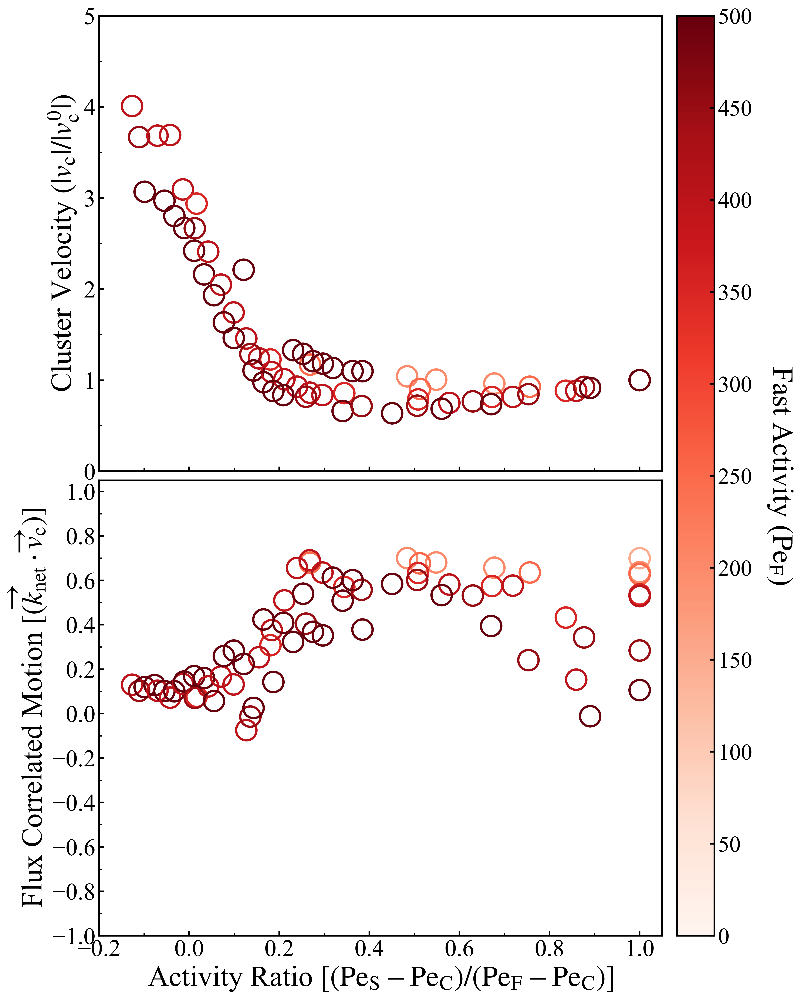

In [8]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params2 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params2 = params2.append(df, ignore_index = True)
display(params2)

C:\Users\Nick\AppData\Local\Temp\ipykernel_4660\1466175664.py:43: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


[]
[40]
[60]


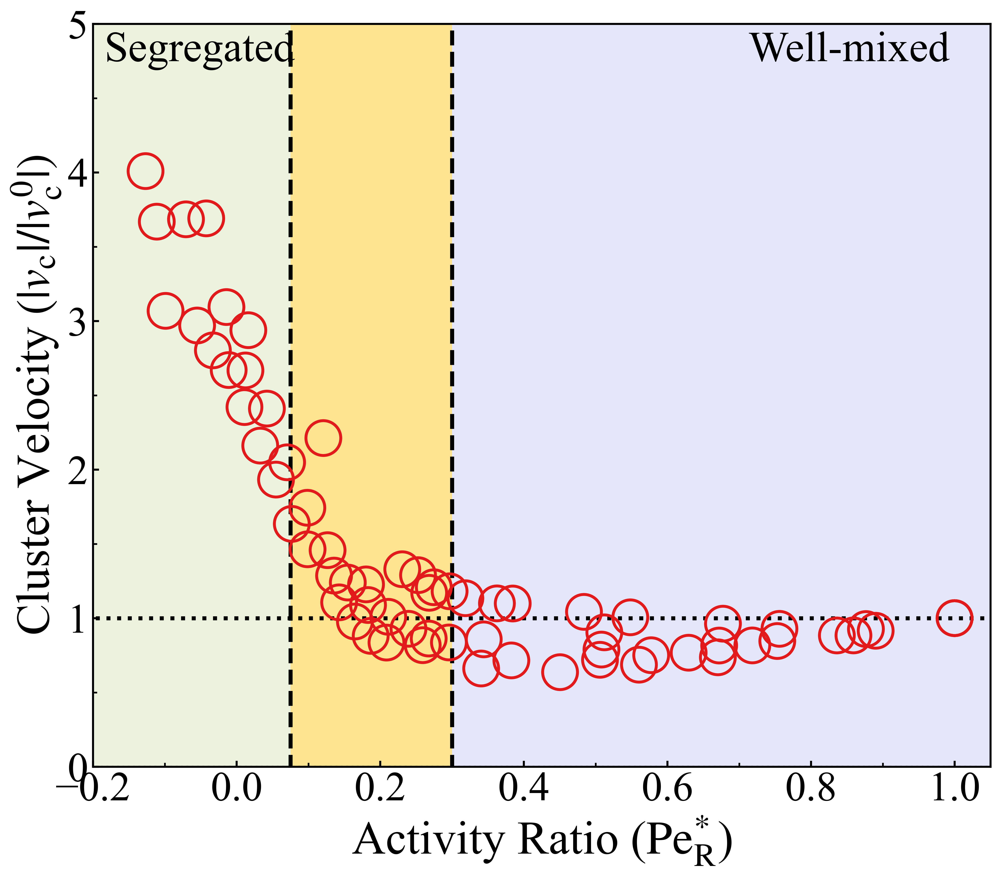

In [11]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres)):
    # Ger rid of NaN in favor of 0
    all_pres[i].fillna(0, inplace=True)

headers=list(all_pres[0])
display(all_pres[0])
print(all_pres[0][headers[1]][0])
print(all_pres[0][headers[2]][0])

/var/folders/vm/hmx8k_5n685f83yqn3k270xw0000gs/T/ipykernel_2466/47318282.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = matplotlib.cm.get_cmap('Set2')
/var/folders/vm/hmx8k_5n685f83yqn3k270xw0000gs/T/ipykernel_2466/47318282.py:31: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.8.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


[]
[]
[]


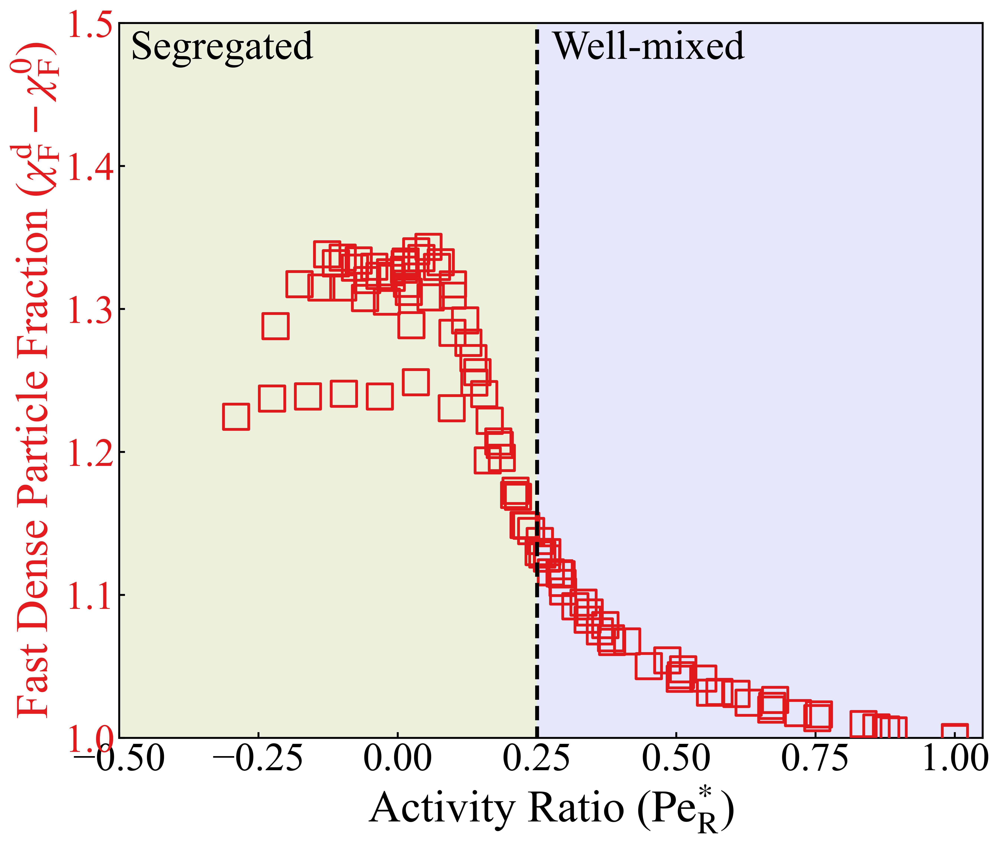

In [10]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres2:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 

# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres2, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new = []
os.chdir(parent)
os.chdir('./xa_txt_files/BubComp')
for i in pres2:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_pres_new.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new[-1])
print(storeVals)

/var/folders/vm/hmx8k_5n685f83yqn3k270xw0000gs/T/ipykernel_2251/1672881891.py:13: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = matplotlib.cm.get_cmap('Set2')
/var/folders/vm/hmx8k_5n685f83yqn3k270xw0000gs/T/ipykernel_2251/1672881891.py:21: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.8.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


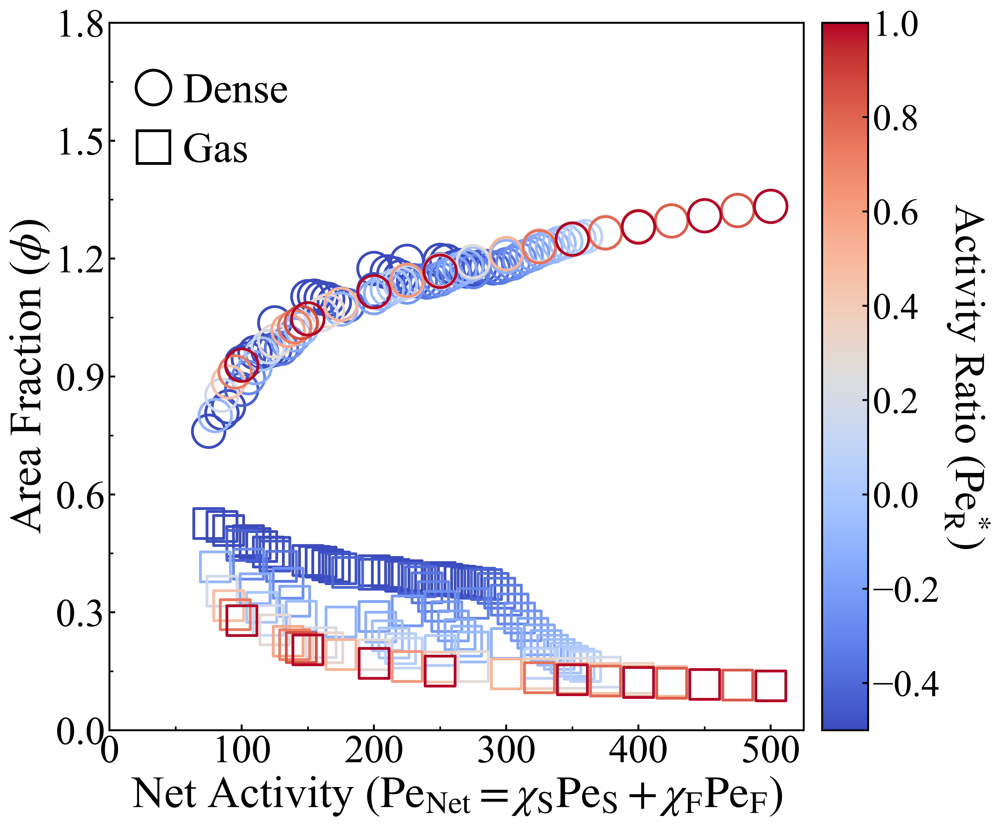

In [91]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params3 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params3 = params3.append(df, ignore_index = True)
display(params3)

/var/folders/vm/hmx8k_5n685f83yqn3k270xw0000gs/T/ipykernel_2251/1552491719.py:13: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = matplotlib.cm.get_cmap('Set2')
/var/folders/vm/hmx8k_5n685f83yqn3k270xw0000gs/T/ipykernel_2251/1552491719.py:21: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.8.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


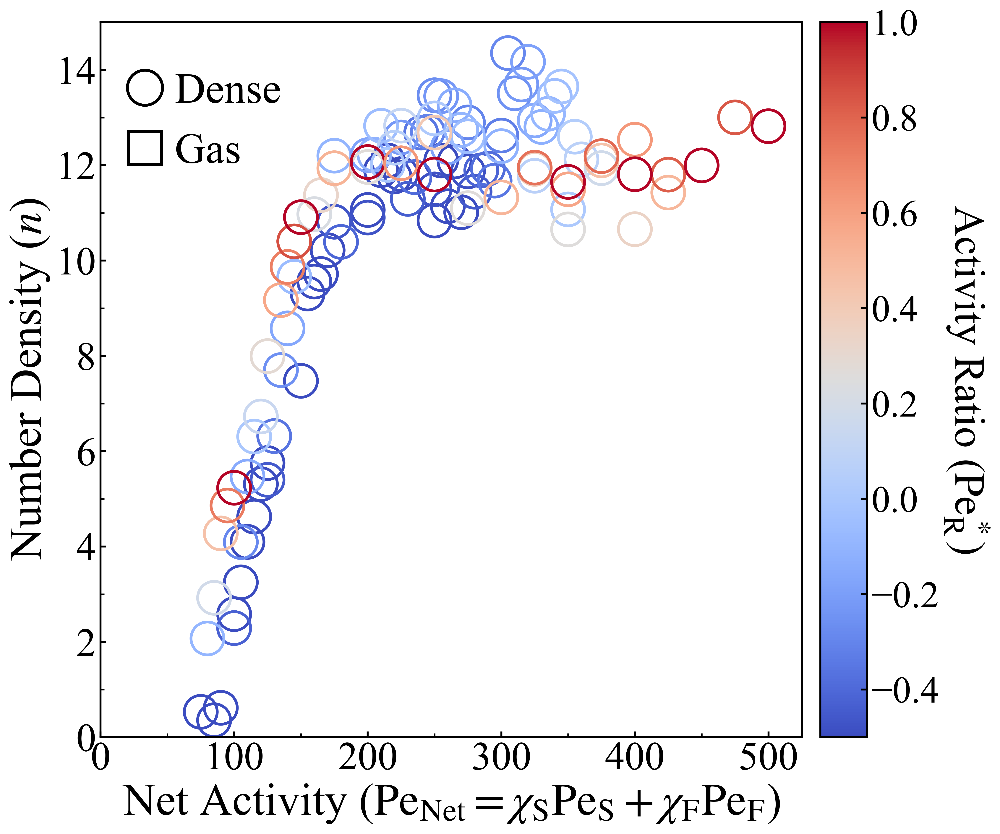

/var/folders/vm/hmx8k_5n685f83yqn3k270xw0000gs/T/ipykernel_2251/1552491719.py:123: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = matplotlib.cm.get_cmap('Set2')
/var/folders/vm/hmx8k_5n685f83yqn3k270xw0000gs/T/ipykernel_2251/1552491719.py:131: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.8.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


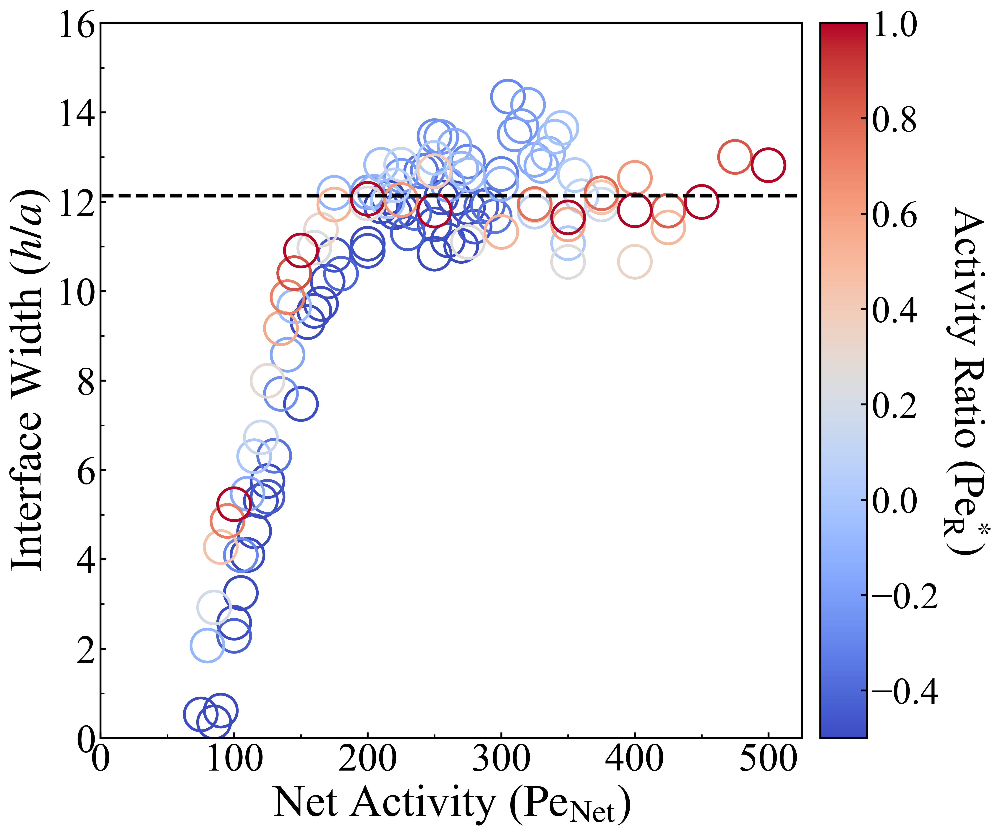

In [70]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new)):
    # Ger rid of NaN in favor of 0
    all_pres_new[i].fillna(0, inplace=True)

headers=list(all_pres_new[0])
display(all_pres_new[0])
print(all_pres_new[0][headers[1]][0])
print(all_pres_new[0][headers[2]][0])

/var/folders/vm/hmx8k_5n685f83yqn3k270xw0000gs/T/ipykernel_18409/4234366650.py:13: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = matplotlib.cm.get_cmap('Set2')
/var/folders/vm/hmx8k_5n685f83yqn3k270xw0000gs/T/ipykernel_18409/4234366650.py:21: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.8.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


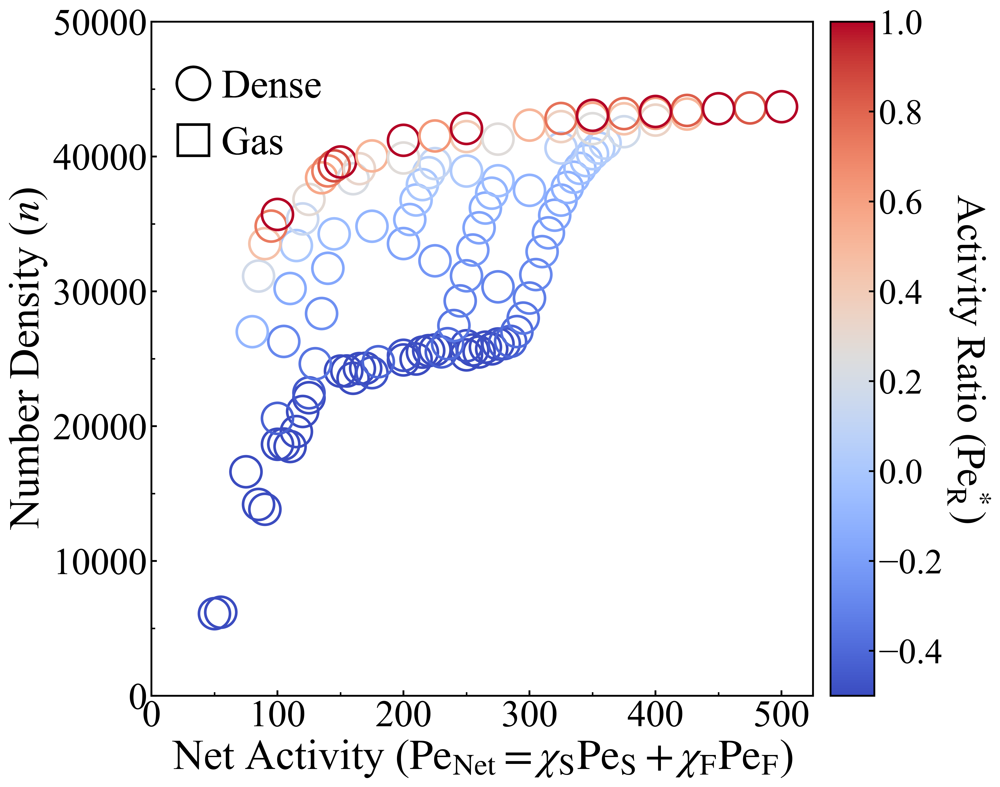

In [127]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres3:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 

# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres3, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new2 = []
os.chdir(parent)
os.chdir('./xa_txt_files/PhaseComp')
for i in pres3:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_pres_new2.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new2[-1])
print(storeVals)

C:\Users\Nick\AppData\Local\Temp\ipykernel_1056\2075971989.py:21: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


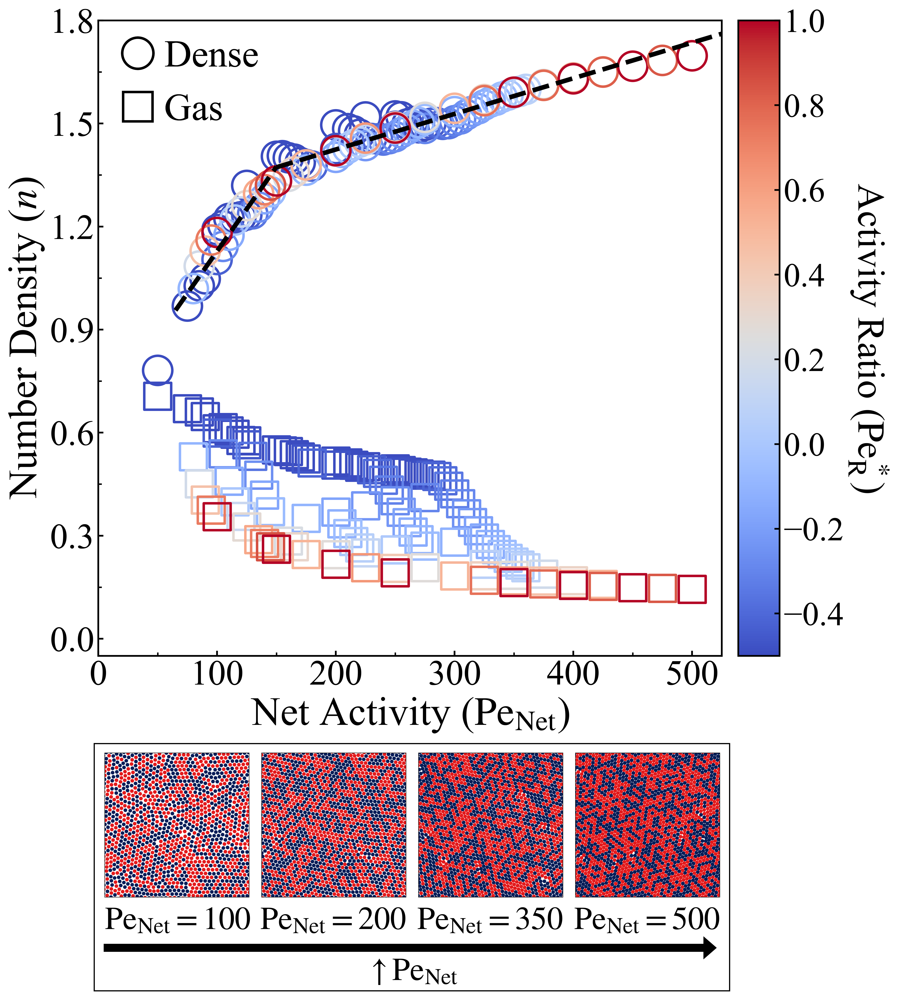

In [57]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params4 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new2)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params4 = params4.append(df, ignore_index = True)
display(params4)

C:\Users\Nick\AppData\Local\Temp\ipykernel_22556\947389200.py:23: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


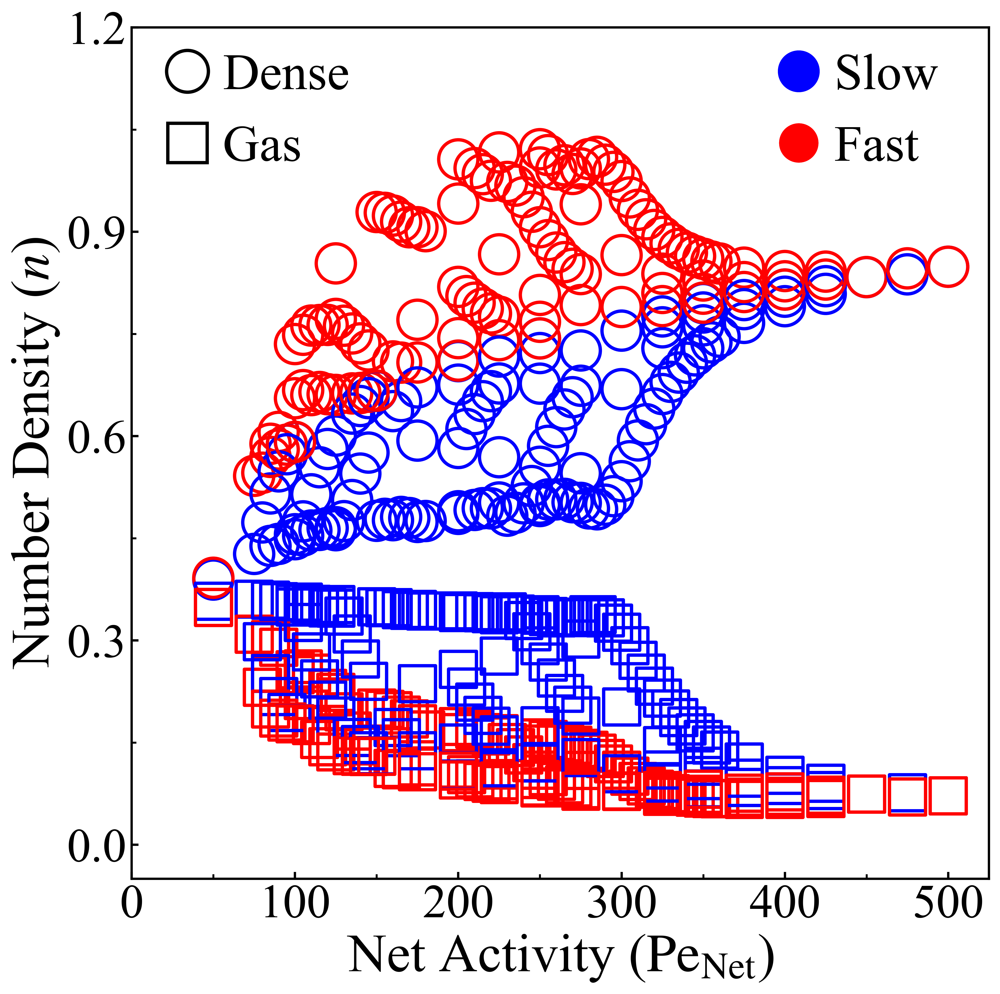

C:\Users\Nick\AppData\Local\Temp\ipykernel_22556\947389200.py:142: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


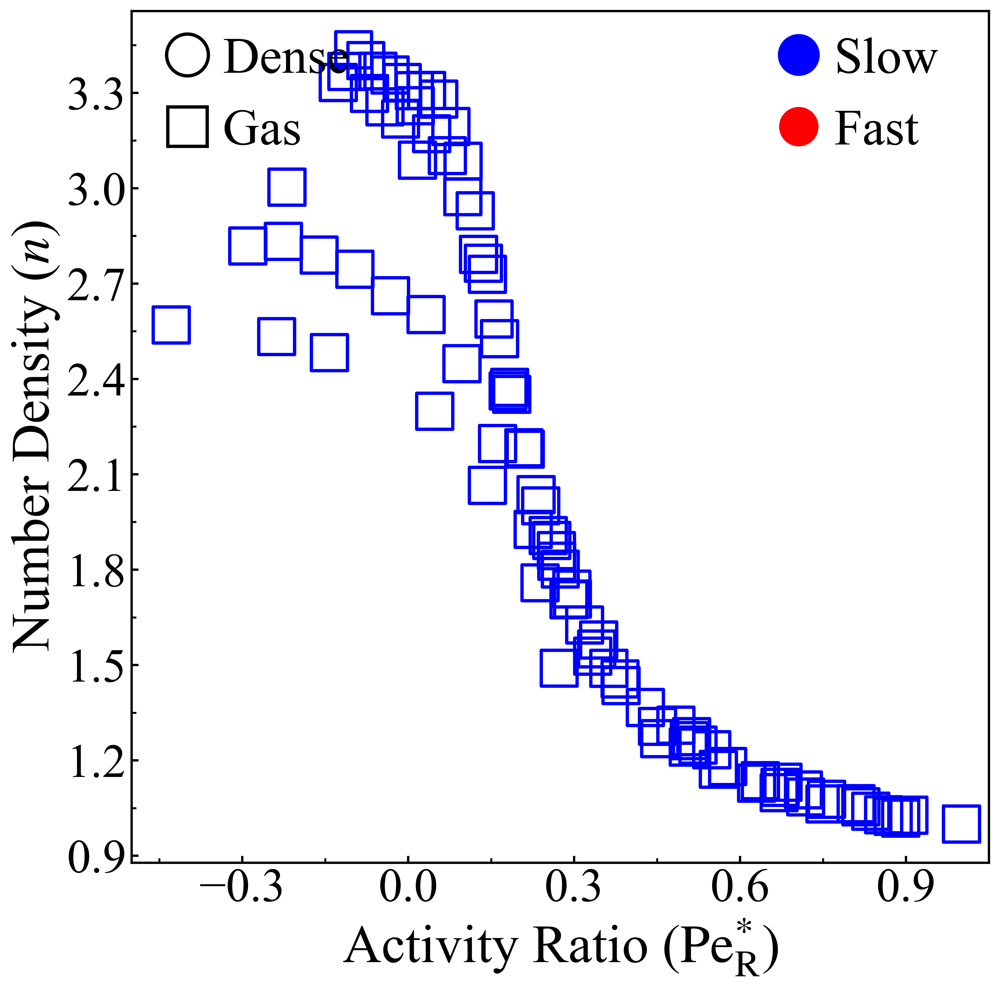

C:\Users\Nick\AppData\Local\Temp\ipykernel_22556\947389200.py:257: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


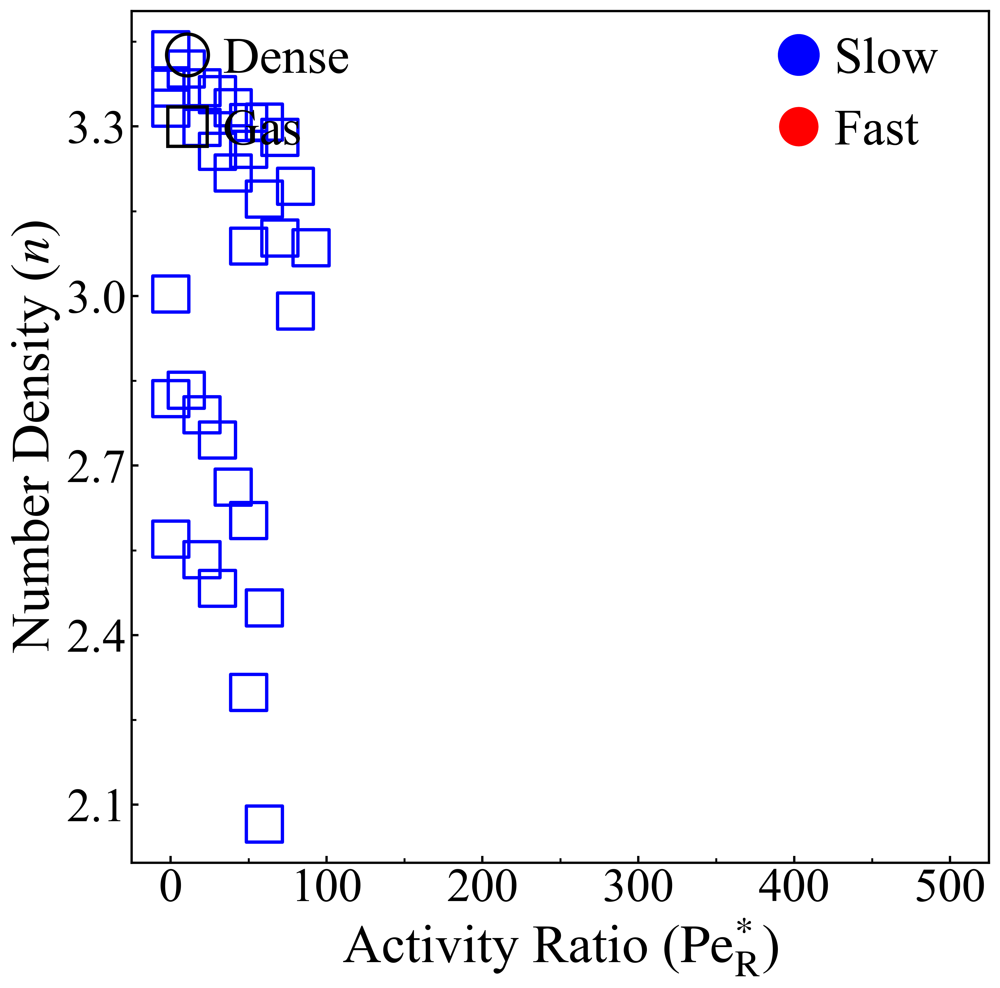

C:\Users\Nick\AppData\Local\Temp\ipykernel_22556\947389200.py:373: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


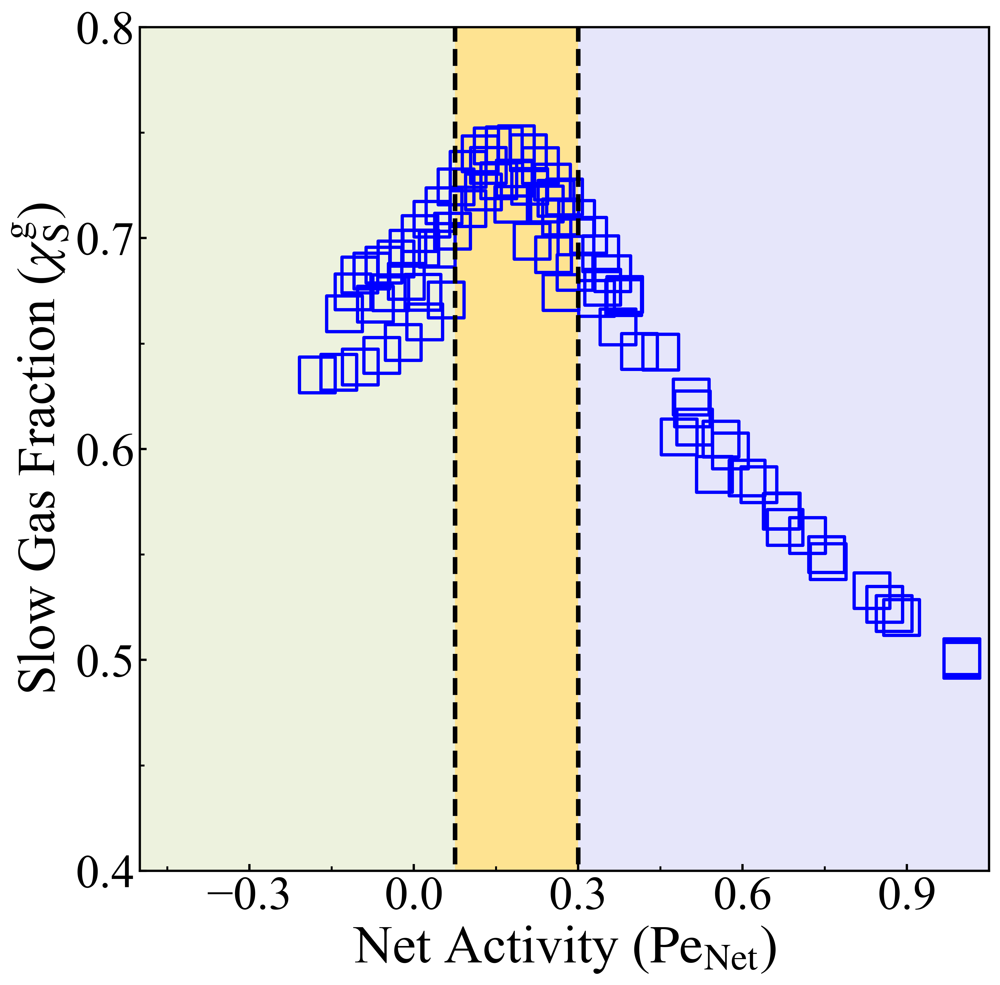

C:\Users\Nick\AppData\Local\Temp\ipykernel_22556\947389200.py:459: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


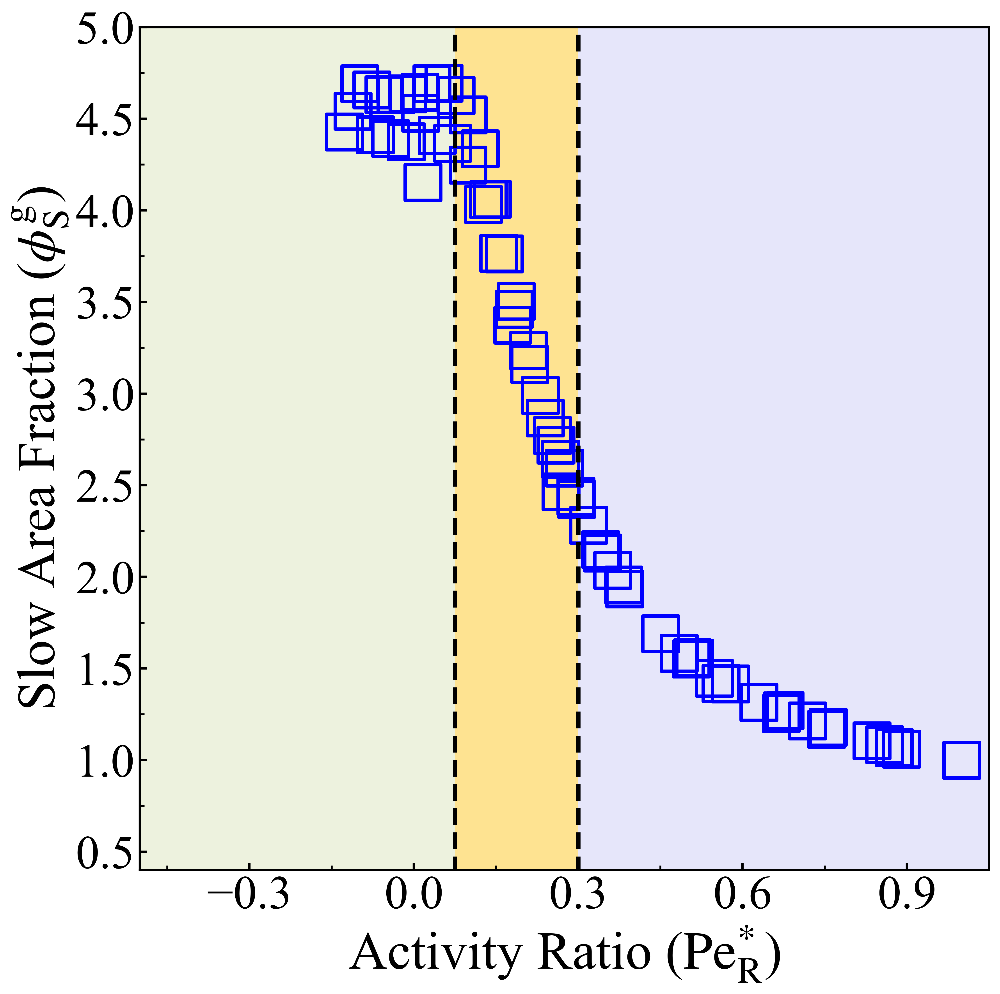

C:\Users\Nick\AppData\Local\Temp\ipykernel_22556\947389200.py:548: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


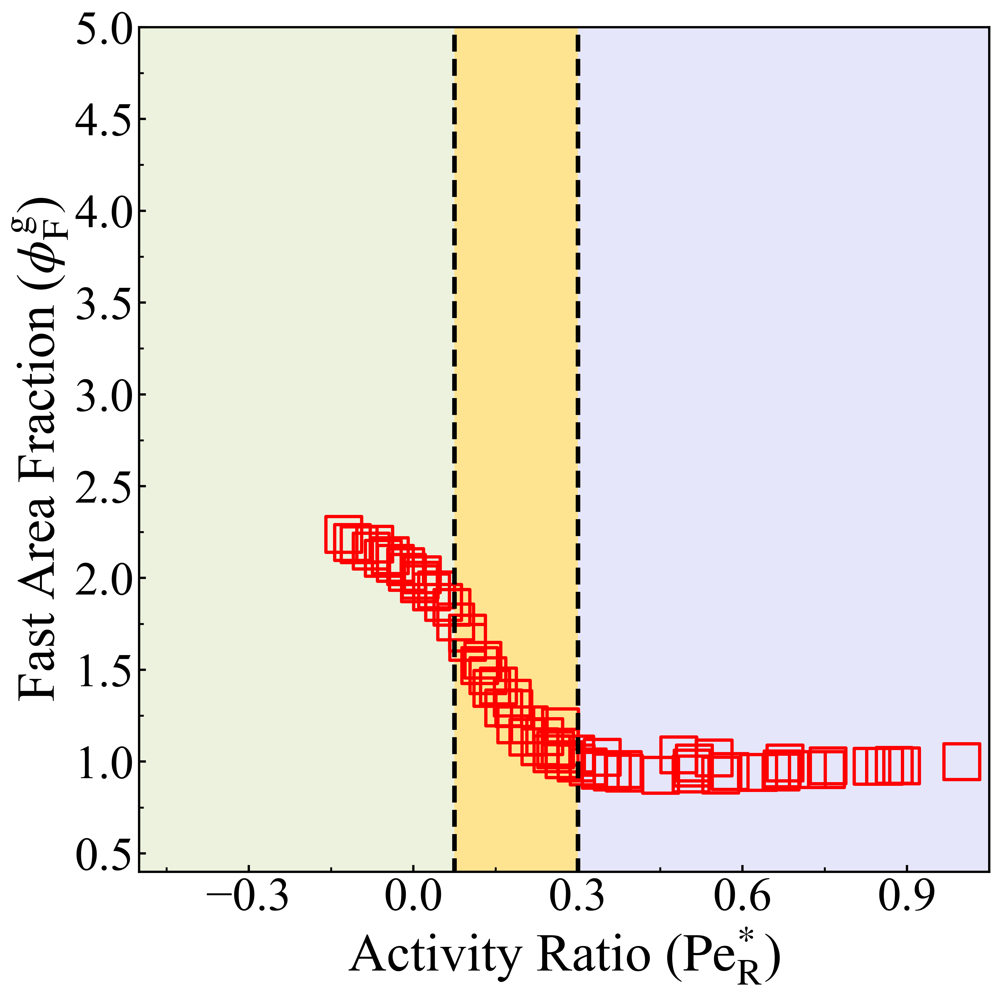

C:\Users\Nick\AppData\Local\Temp\ipykernel_22556\947389200.py:635: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


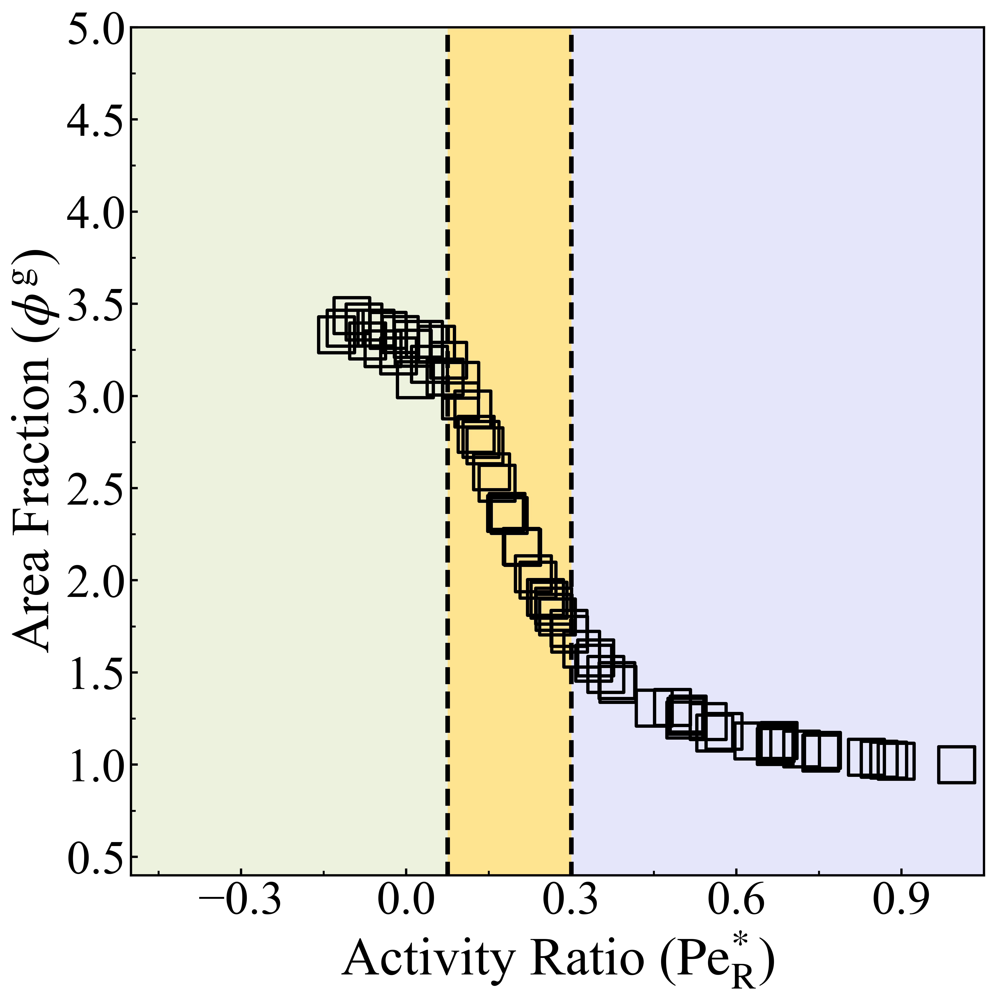

C:\Users\Nick\AppData\Local\Temp\ipykernel_22556\947389200.py:743: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_22556\947389200.py:775: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_gas_nB[temp_id][i]/avg_gas_n[temp_id][i]), zorder = 1, edgecolor='None', facecolor='red', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


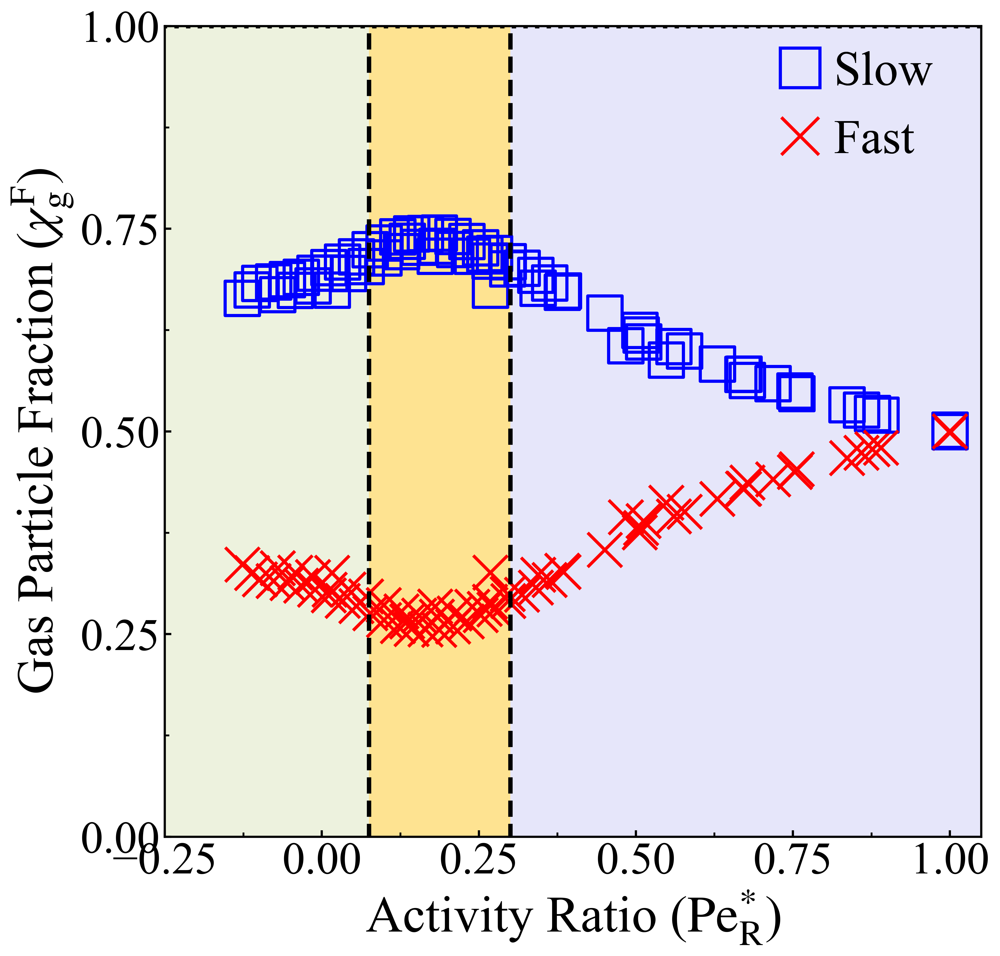

C:\Users\Nick\AppData\Local\Temp\ipykernel_22556\947389200.py:847: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_22556\947389200.py:879: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_dense_nB[temp_id][i]/avg_dense_n[temp_id][i]), zorder = 1, edgecolor='None', facecolor='red', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


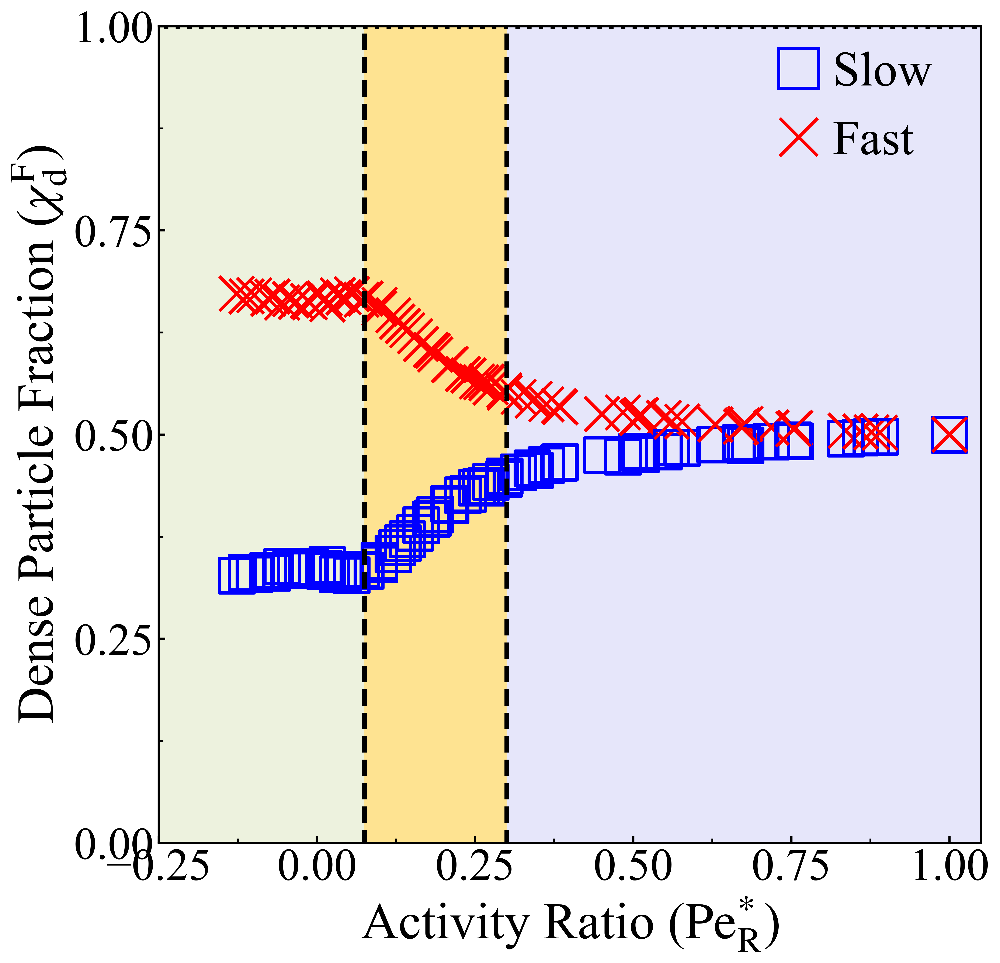

NameError: name 'stop' is not defined

In [42]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new2)):
    # Ger rid of NaN in favor of 0
    all_pres_new2[i].fillna(0, inplace=True)

headers=list(all_pres_new2[0])
display(all_pres_new2[0])
print(all_pres_new2[0][headers[1]][0])
print(all_pres_new2[0][headers[2]][0])

C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:26: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:58: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_gas_nB[temp_id][i]/avg_gas_n[temp_id][i]), zorder = 1, edgecolor='None', facecolor='red', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


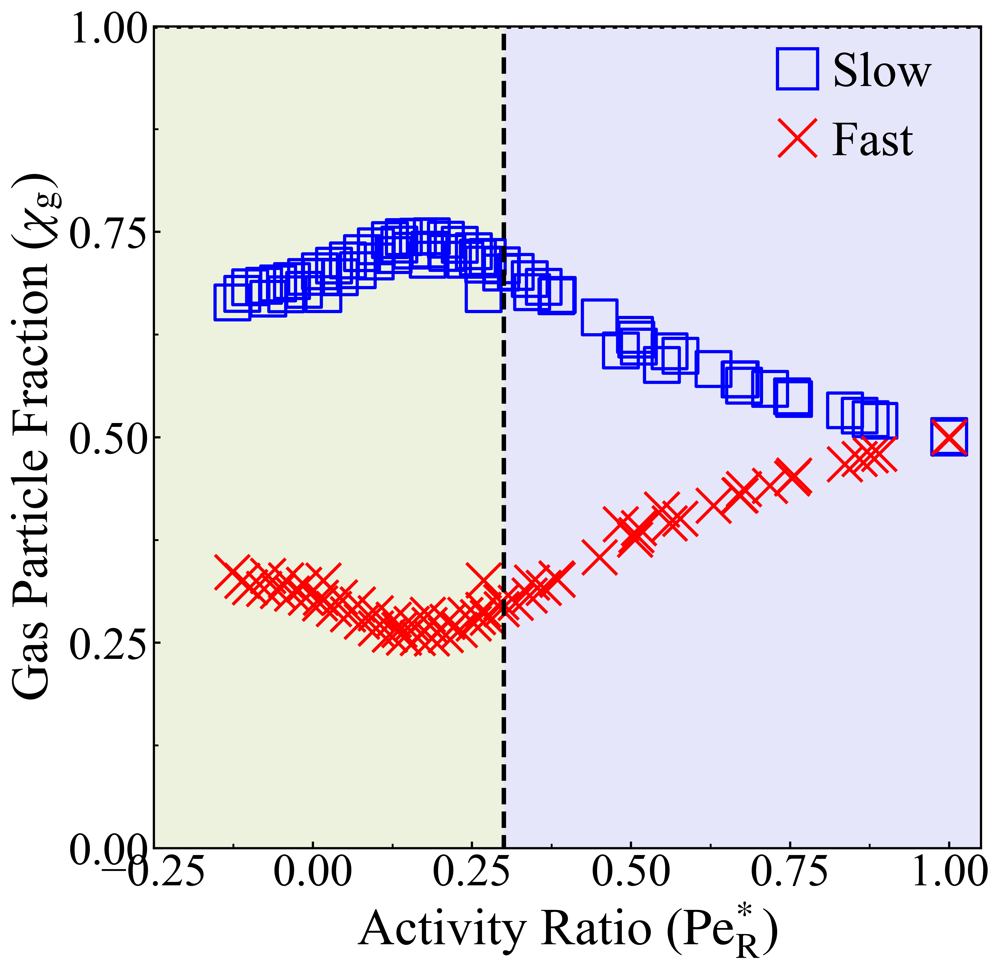

C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:128: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:160: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_dense_nB[temp_id][i]/avg_dense_n[temp_id][i]), zorder = 1, edgecolor='None', facecolor='red', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


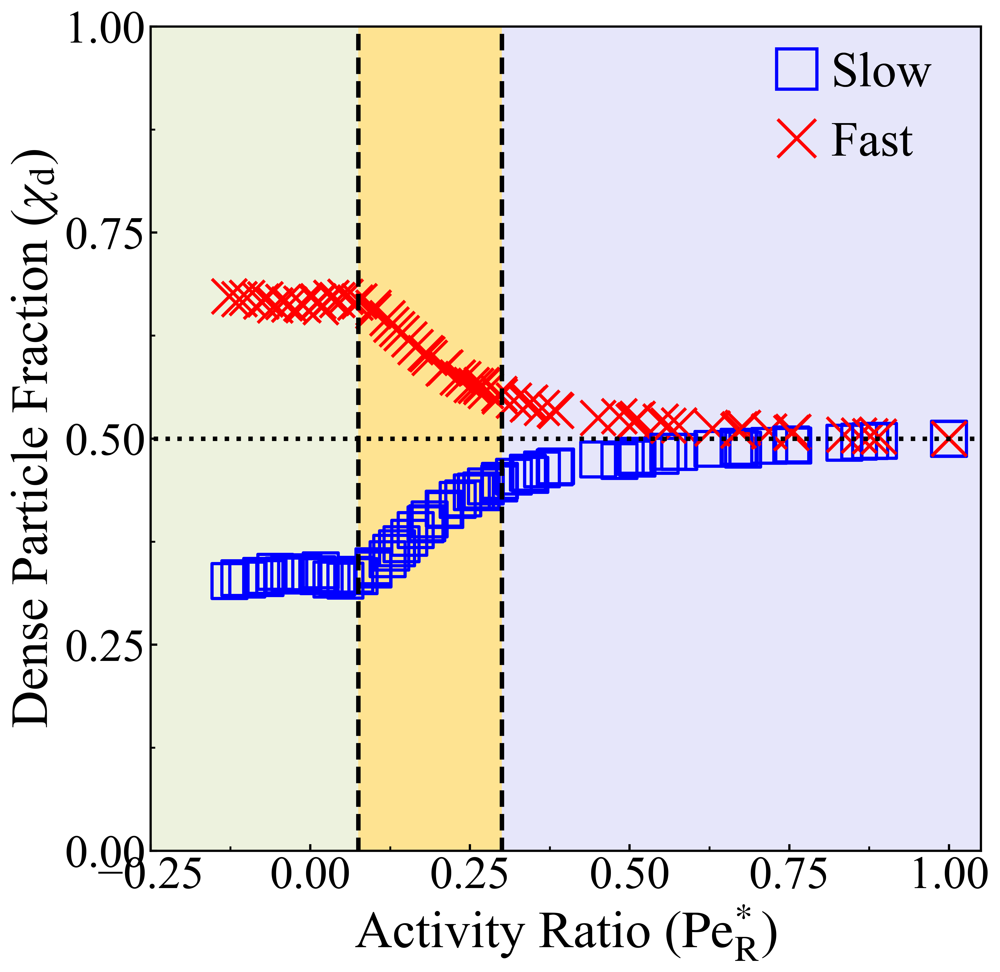

C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:234: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:266: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_gas_nB[temp_id][i]/avg_gas_nB[mono_id]), zorder = 1, edgecolor='None', facecolor='red', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


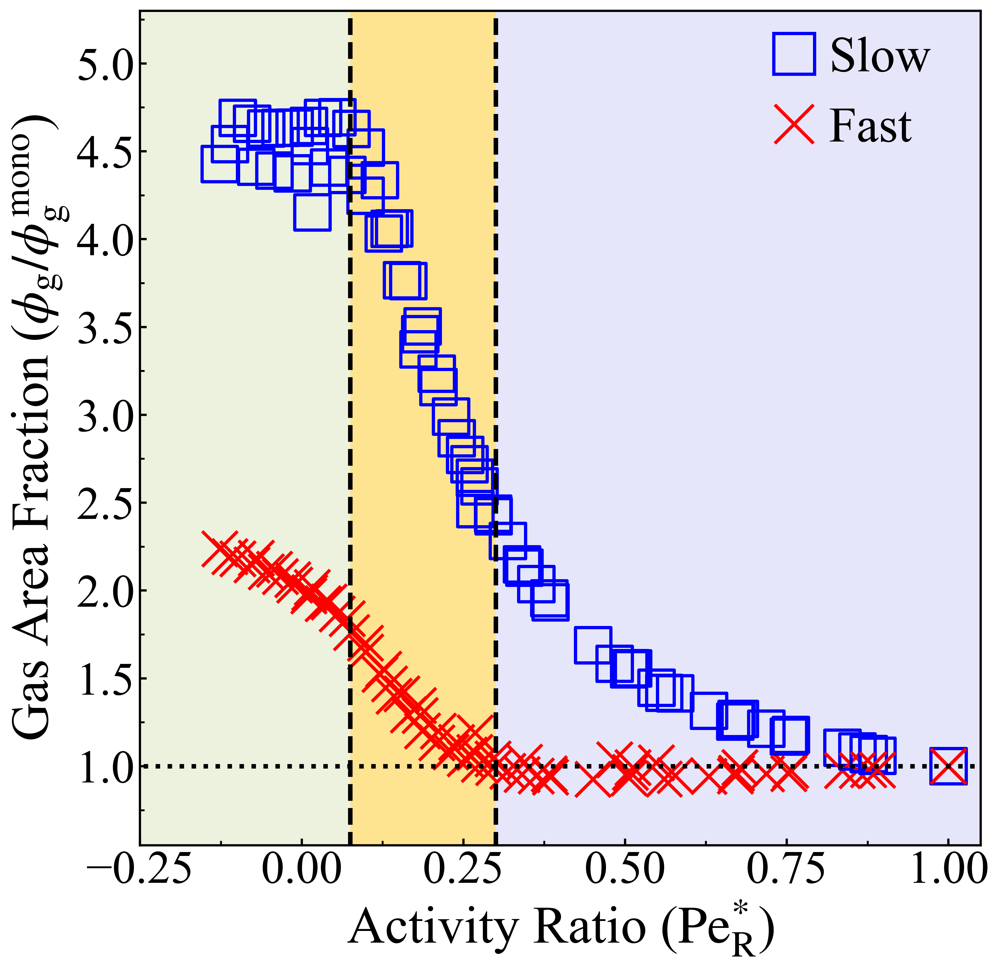

C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:339: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:371: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_gas_nB[temp_id][i]), zorder = 1, edgecolor='None', facecolor='red', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


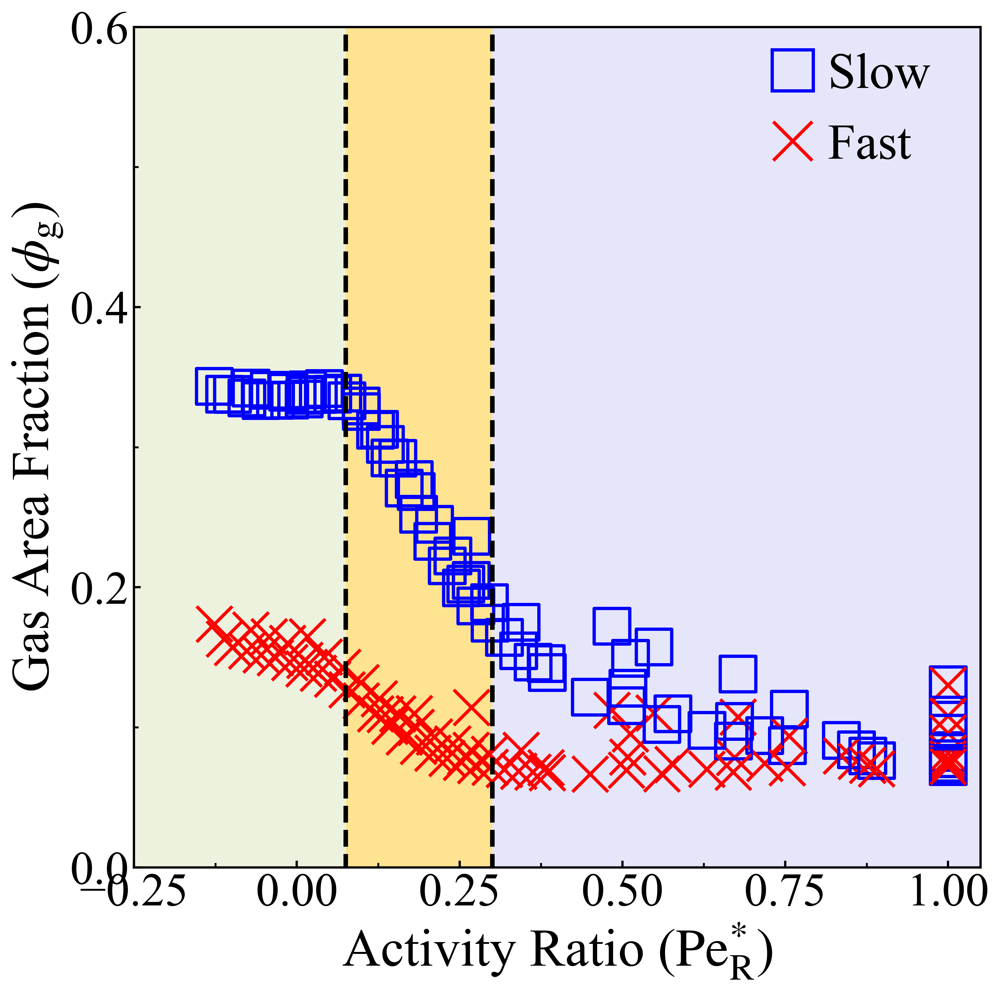

C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:444: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:476: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_dense_nB[temp_id][i]/avg_dense_nB[mono_id]), zorder = 1, edgecolor='None', facecolor='red', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


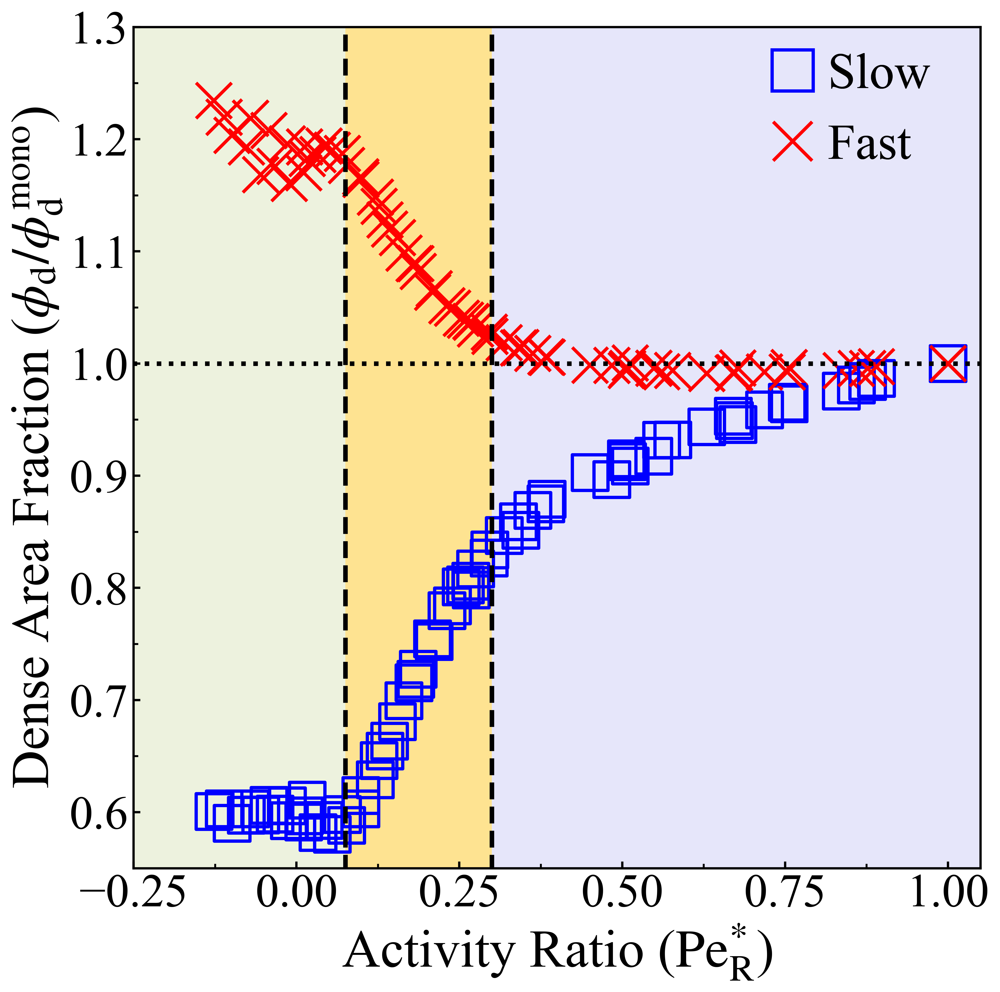

C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:554: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:576: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_gas_n[temp_id][i]/avg_gas_n[mono_id]), zorder = 1, facecolor='black', edgecolor='None', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


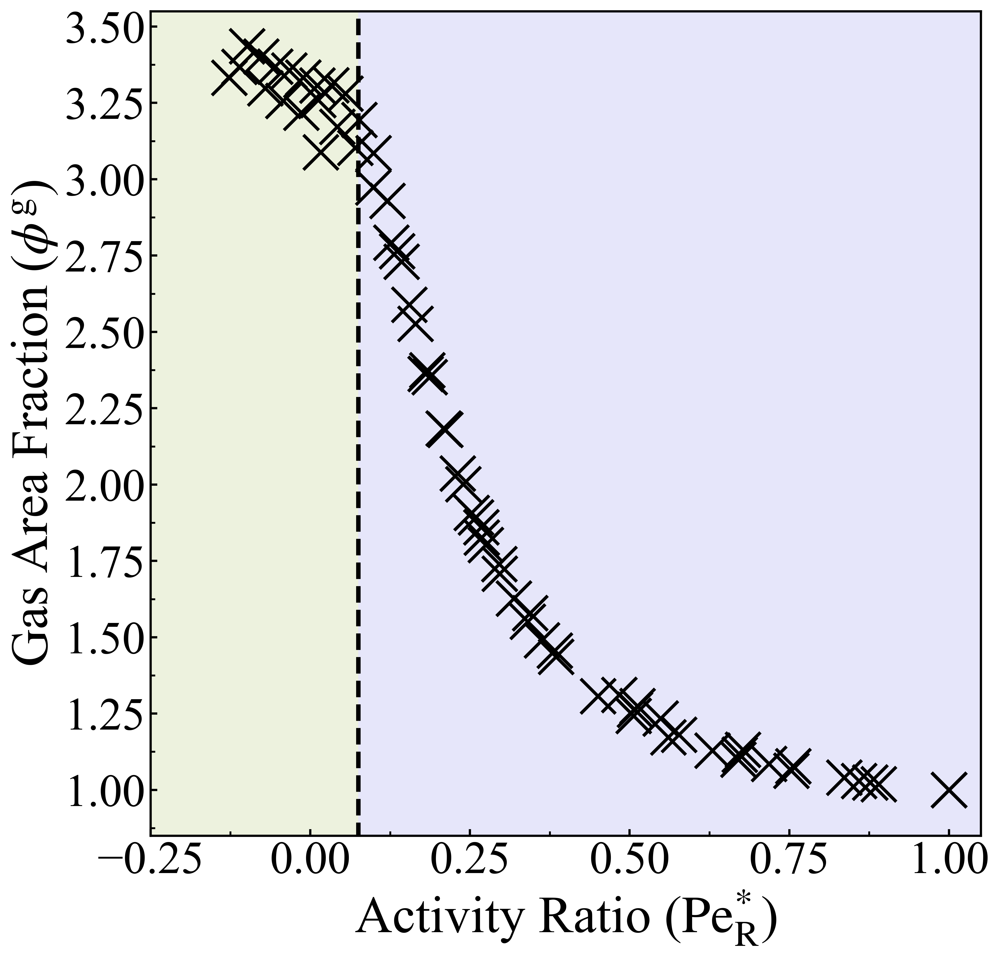

C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:639: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


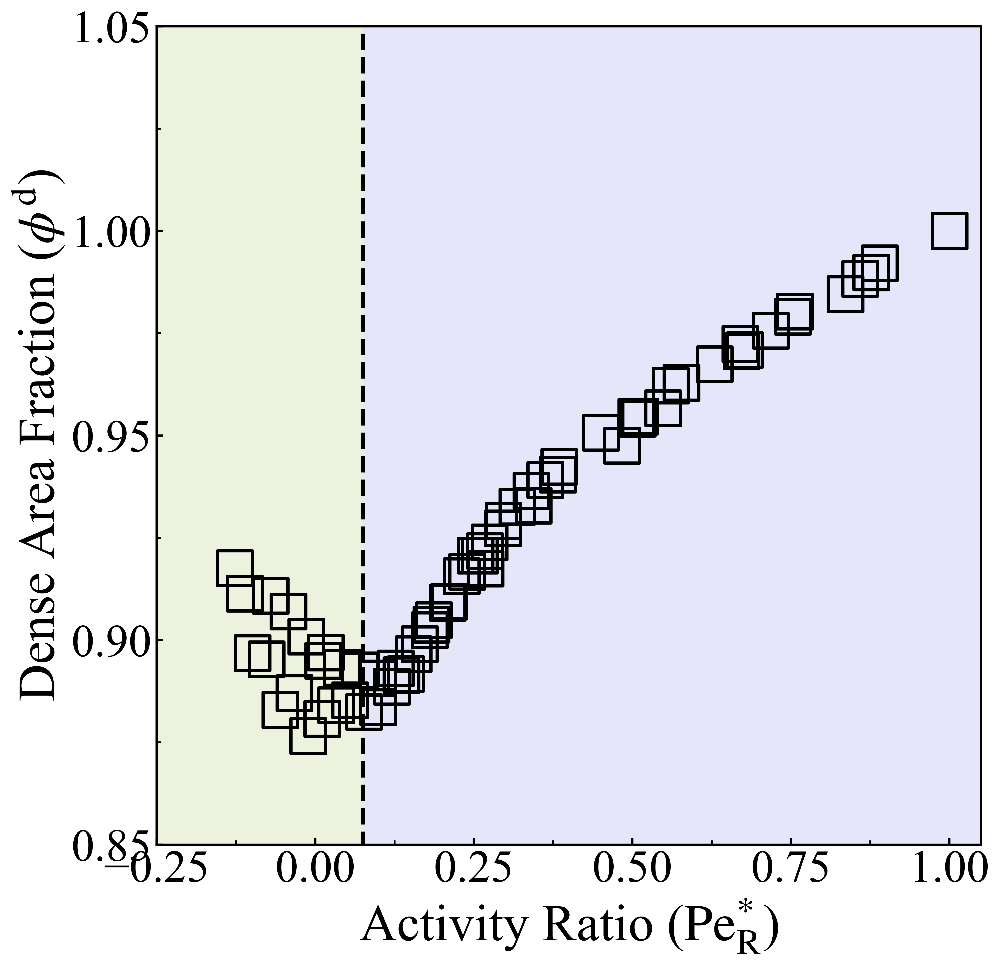

C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:725: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


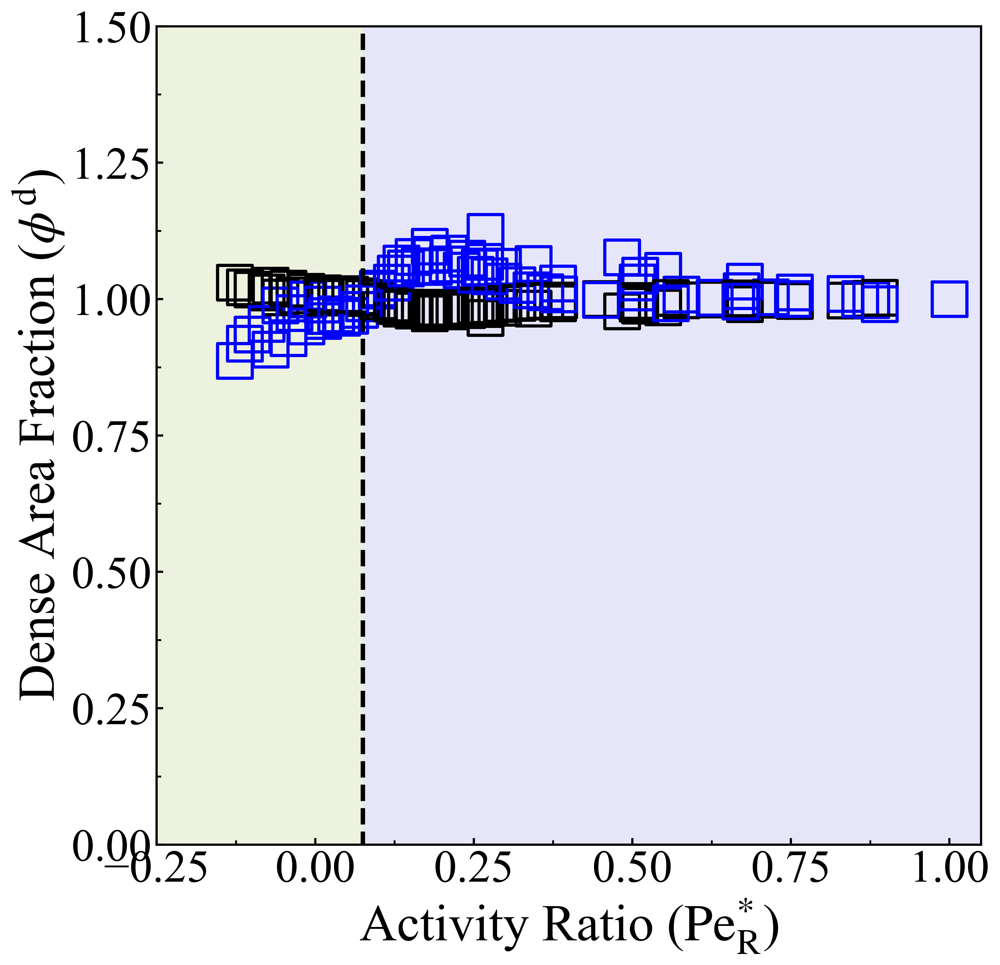

C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:811: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


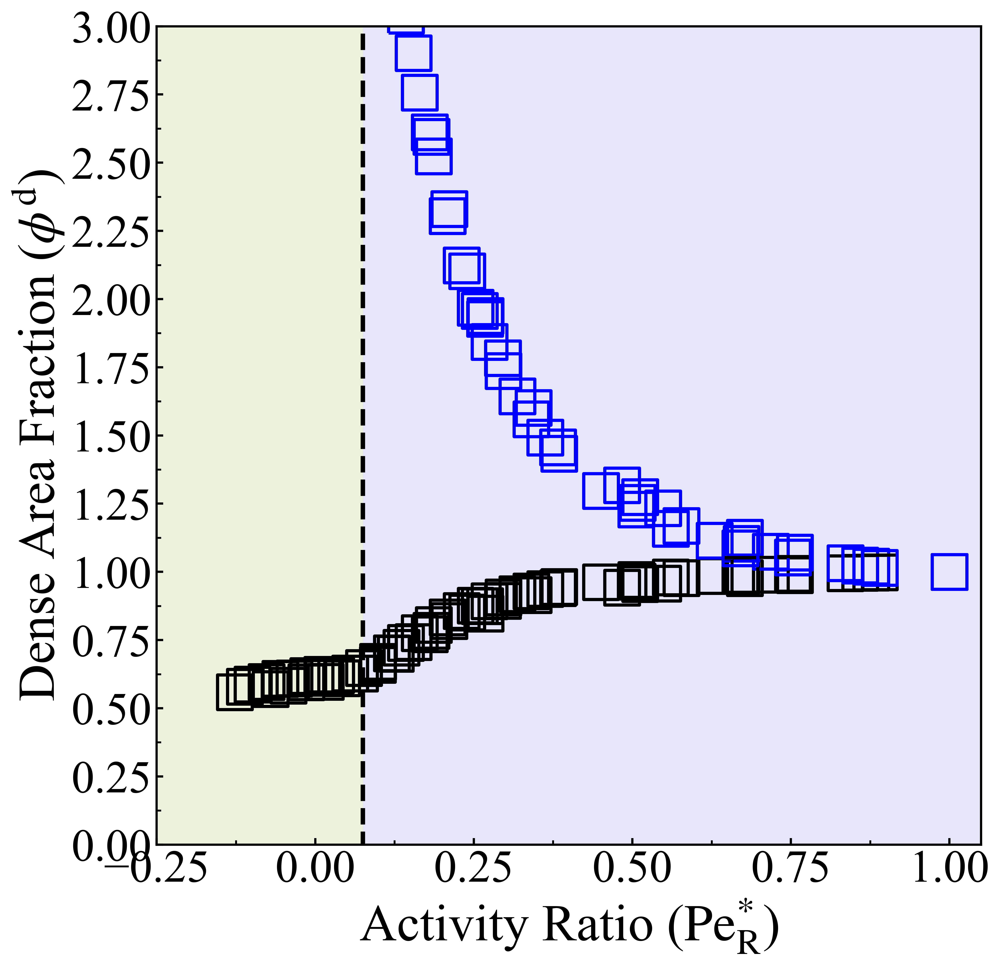

C:\Users\Nick\AppData\Local\Temp\ipykernel_9660\2769473566.py:898: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


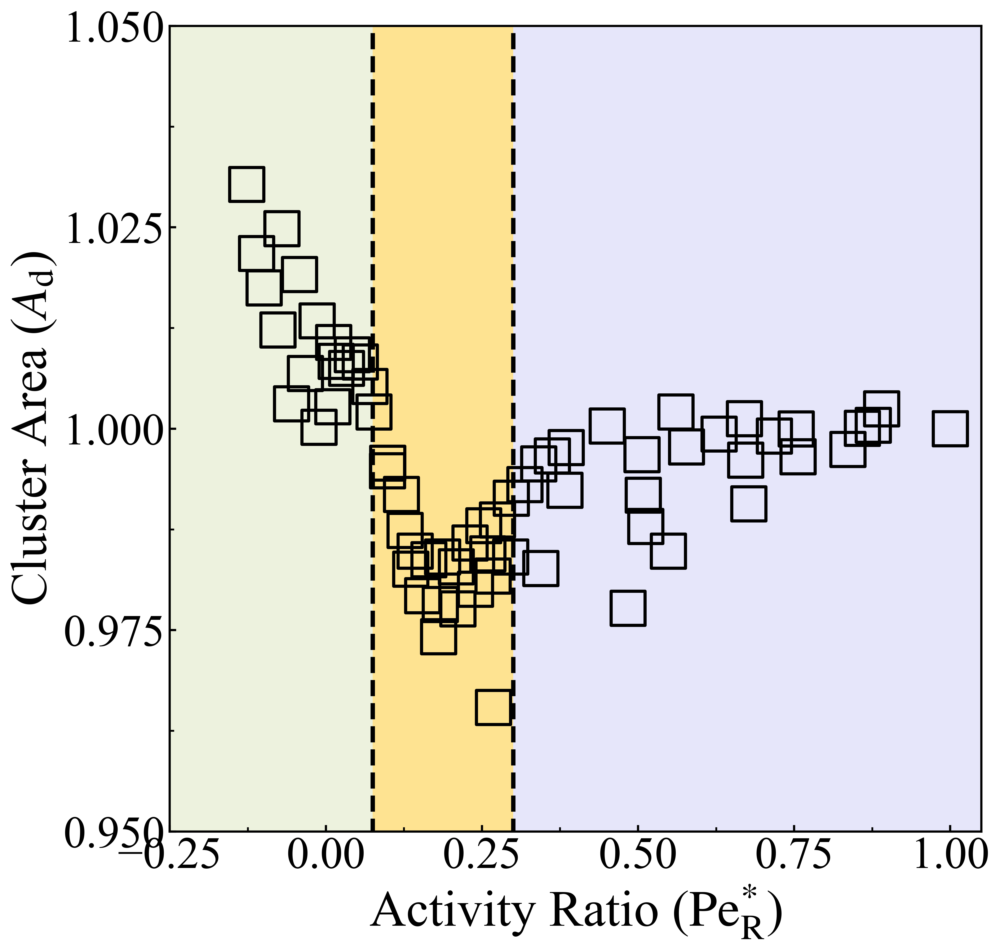

In [22]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres5:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 

# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres5, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new4 = []
os.chdir(parent)
os.chdir('./xa_txt_files/lat_end')
for i in pres5:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_pres_new4.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new4[-1])
print(storeVals)

[  0  20  30  40  50  60  60  70  80  90 100 140 150]
[150 150 150  60 150 100 150 100 100 100 100 150 150]
-0.42857142857142855


C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:30: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:62: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_gas_nB[temp_id][i]/avg_gas_n[temp_id][i]), zorder = 1, edgecolor='None', facecolor='red', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


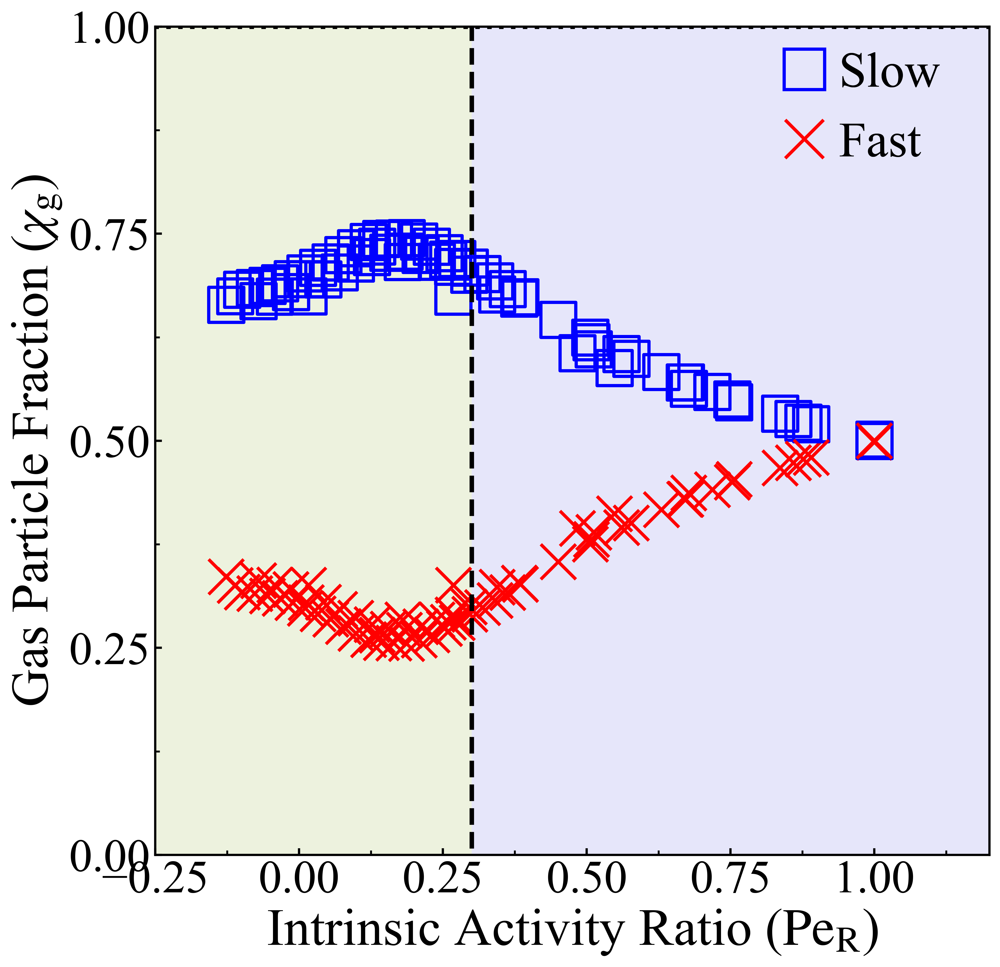

C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:132: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:165: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((vA[temp_id][i] -45) / ( vB[temp_id][i] -45)), (avg_gas_nB[temp_id][i]/avg_gas_n[temp_id][i]), zorder = 1, edgecolor='None', facecolor='red', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


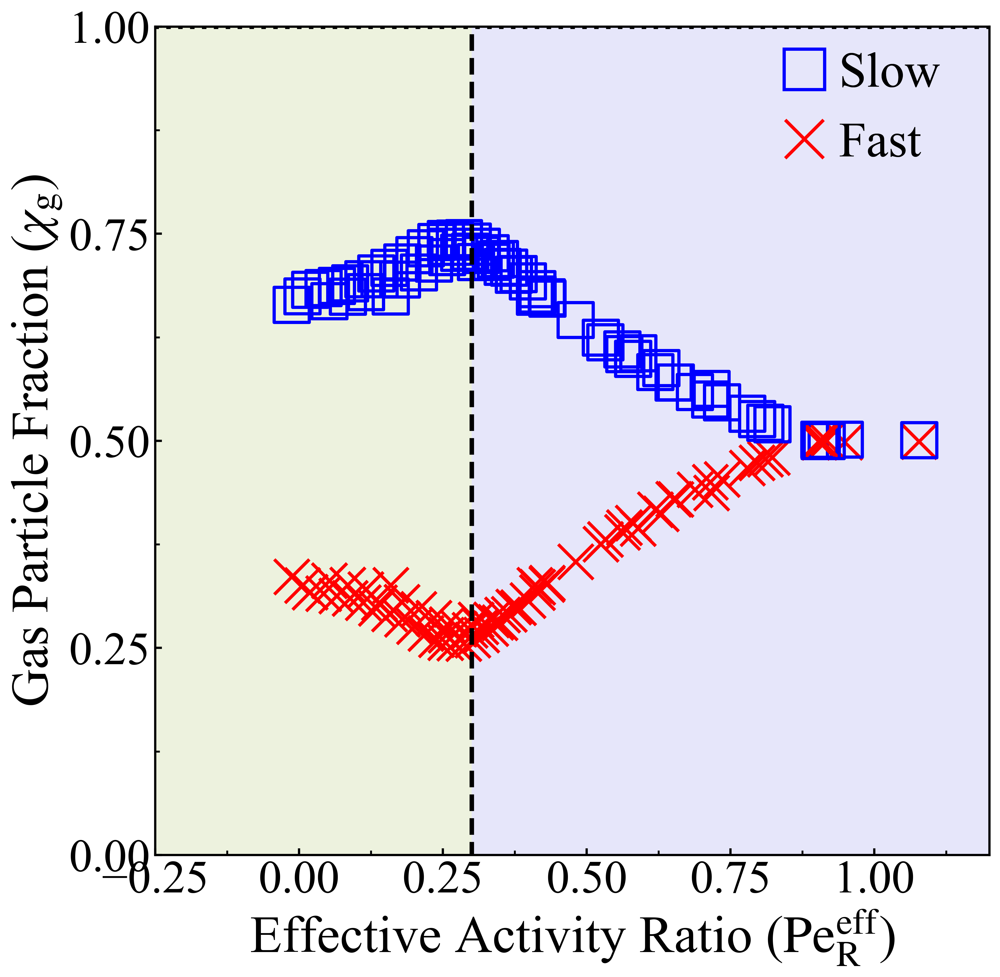

C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:236: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:268: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_dense_nB[temp_id][i]/avg_dense_n[temp_id][i]), zorder = 1, edgecolor='None', facecolor='red', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


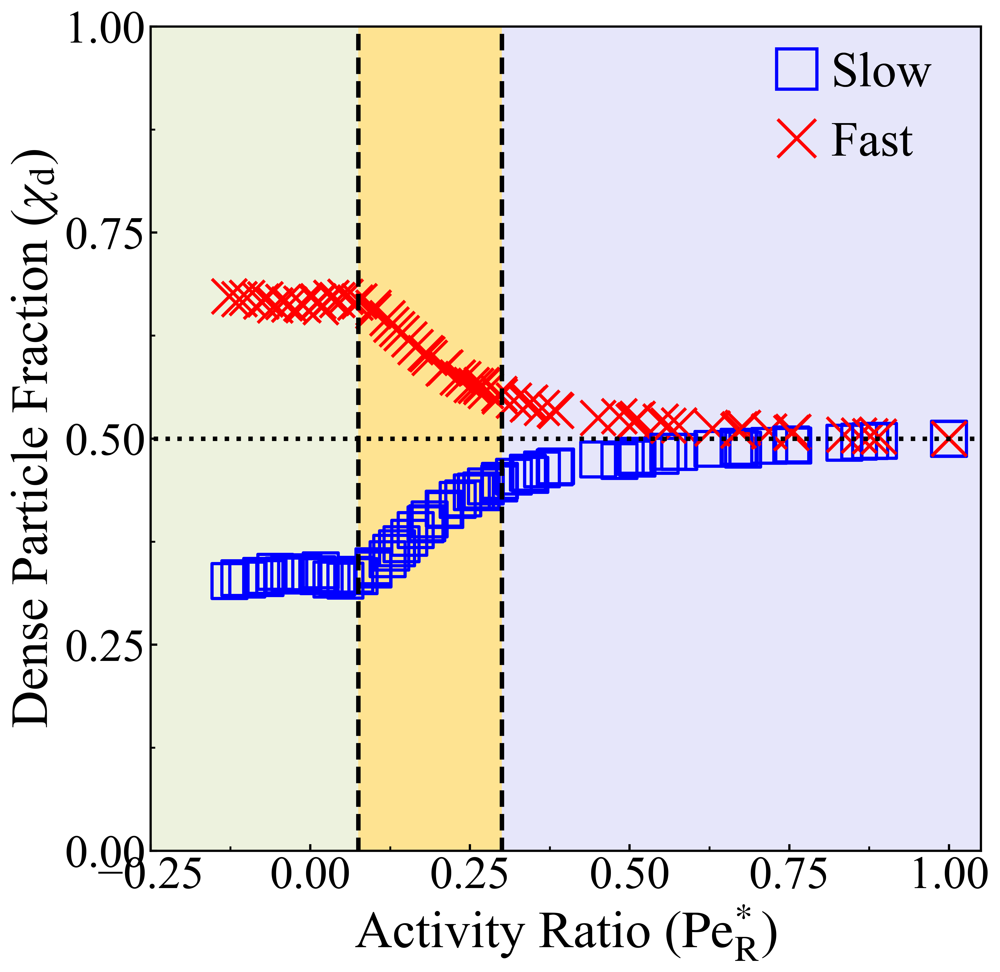

C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:342: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:374: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_gas_nB[temp_id][i]/avg_gas_nB[mono_id]), zorder = 1, edgecolor='None', facecolor='red', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


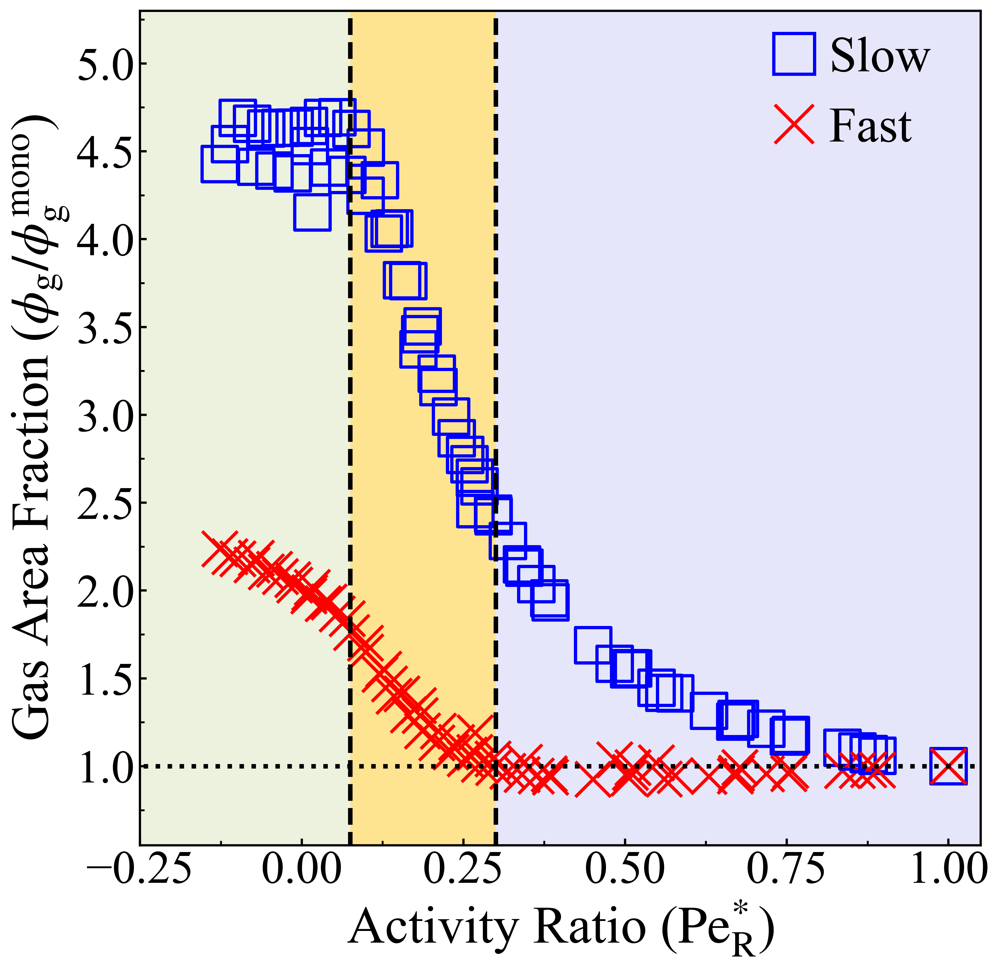

C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:447: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:479: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_gas_nB[temp_id][i]), zorder = 1, edgecolor='None', facecolor='red', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


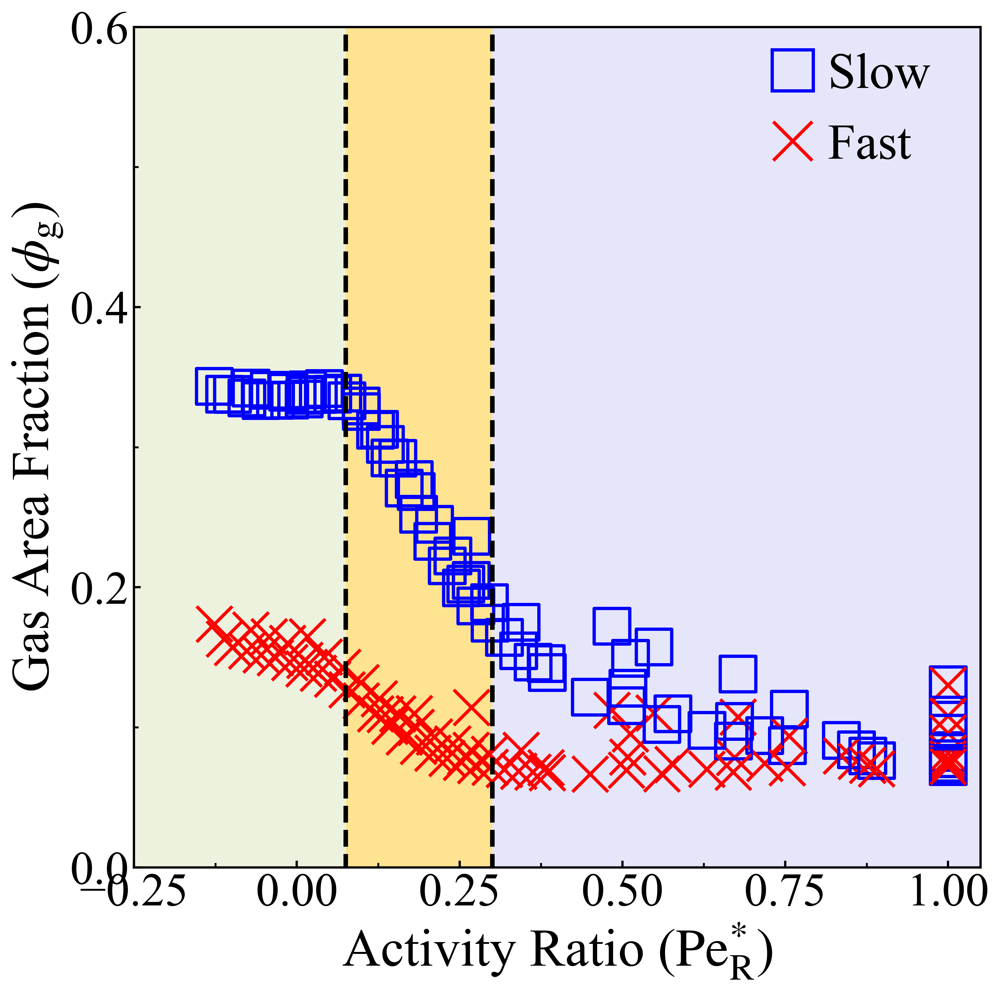

C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:552: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:584: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_dense_nB[temp_id][i]/avg_dense_nB[mono_id]), zorder = 1, edgecolor='None', facecolor='red', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


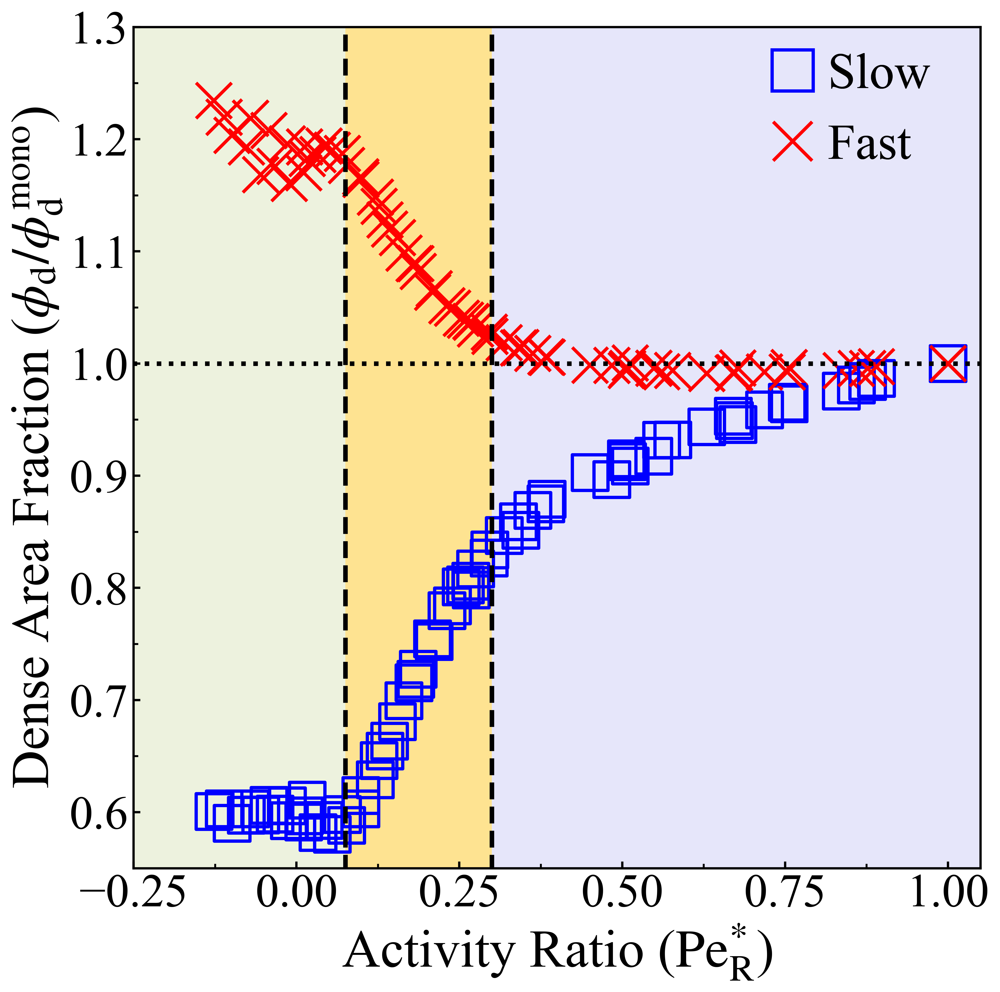

C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:662: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:684: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  im = plt.scatter(((interpart_peA[temp_id][i] -45) / ( interpart_peB[temp_id][i]-45)), (avg_gas_n[temp_id][i]/avg_gas_n[mono_id]), zorder = 1, facecolor='black', edgecolor='None', linewidth = 1.8*1.2, marker='x', s=msz*55, label='Simulation')


-0.42857142857142855


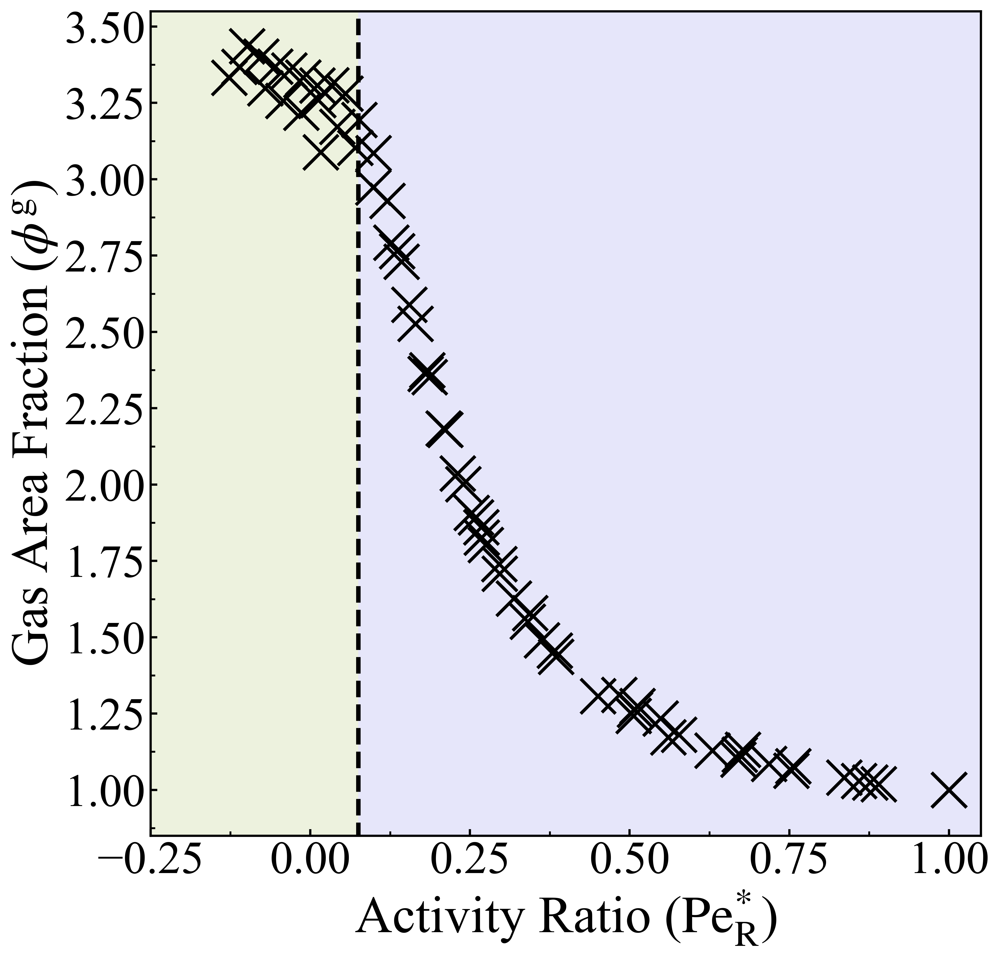

C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:747: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


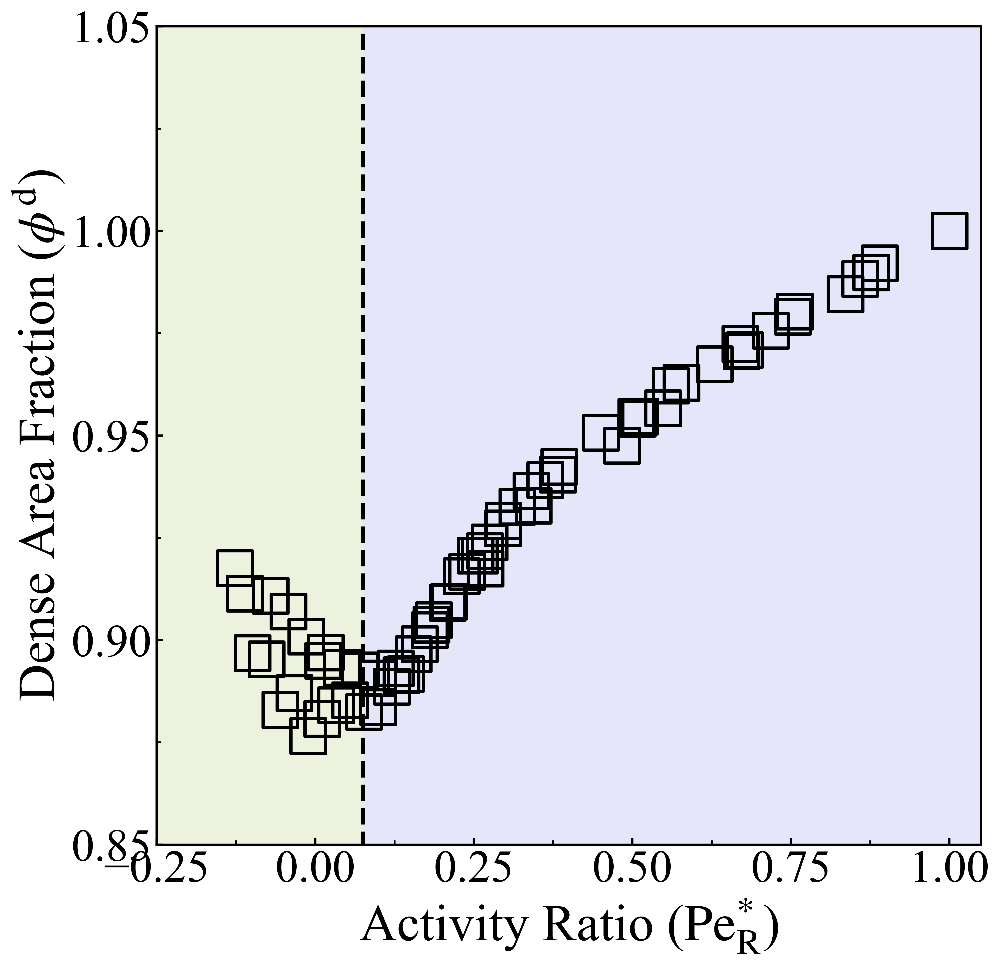

C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:833: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


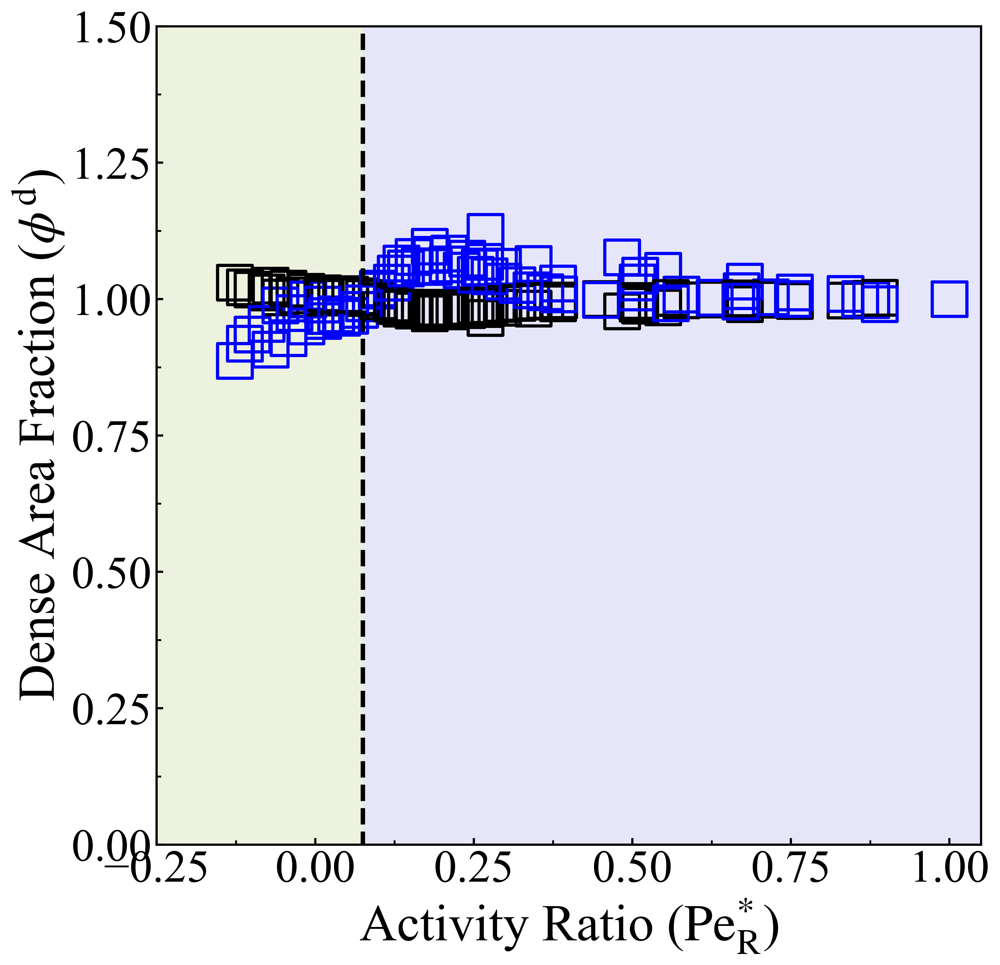

C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:919: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


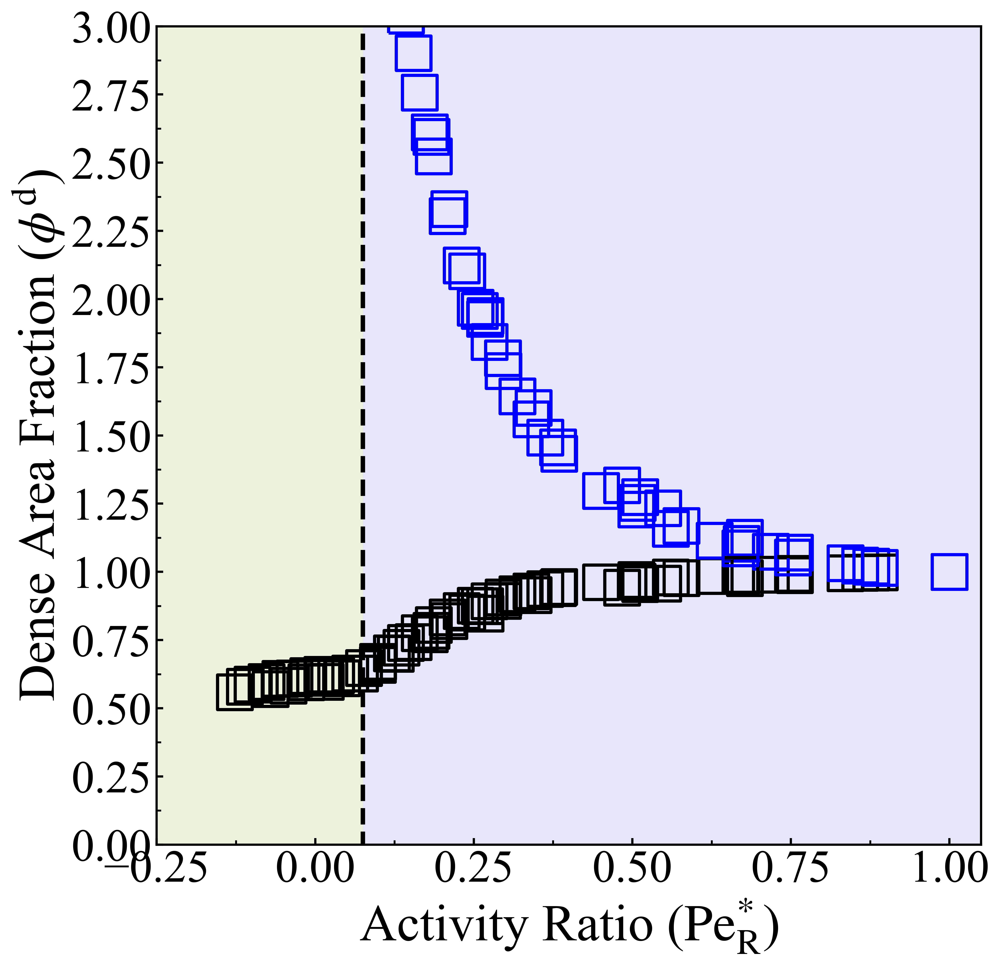

C:\Users\Nick\AppData\Local\Temp\ipykernel_21736\277405246.py:1006: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


-0.42857142857142855


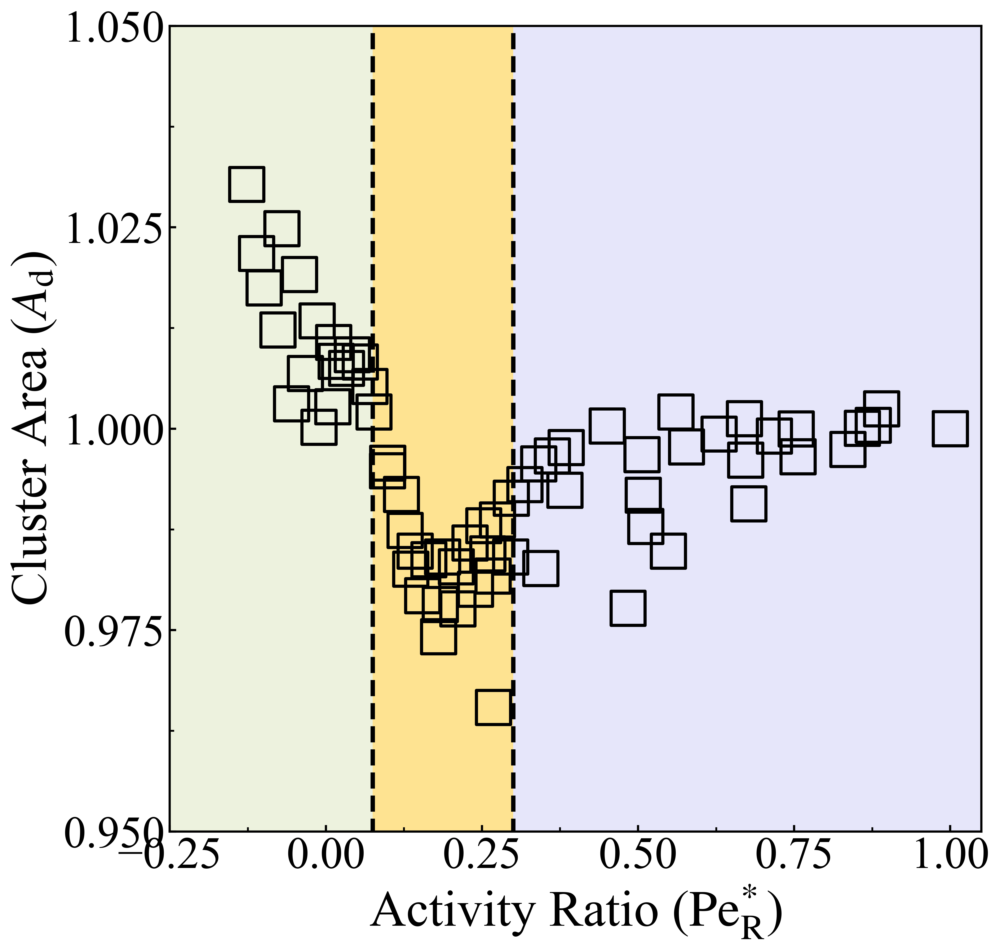

In [17]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params6 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new4)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params6 = params6.append(df, ignore_index = True)
display(params6)

C:\Users\Nick\AppData\Local\Temp\ipykernel_4660\1950236494.py:44: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


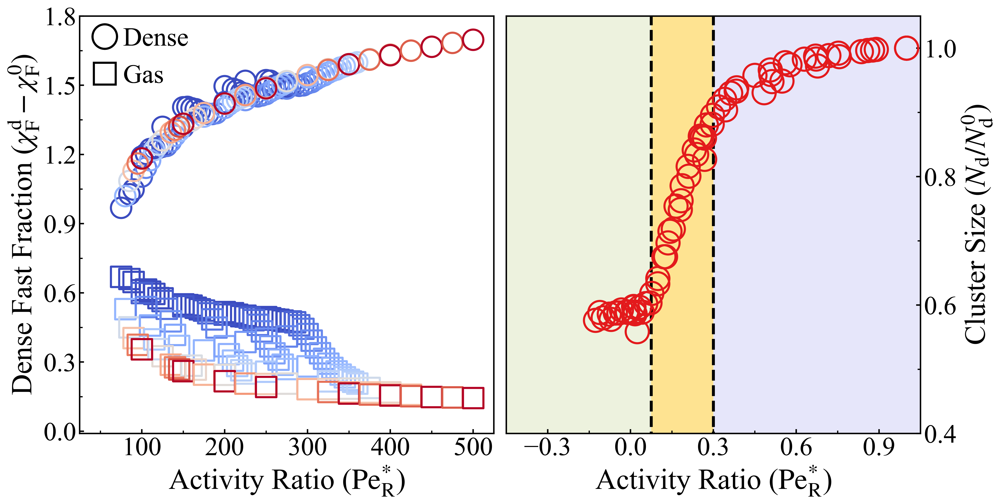

NameError: name 'stop' is not defined

In [19]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new4)):
    # Ger rid of NaN in favor of 0
    all_pres_new4[i].fillna(0, inplace=True)

headers=list(all_pres_new4[0])
display(all_pres_new4[0])
print(all_pres_new4[0][headers[1]][0])
print(all_pres_new4[0][headers[2]][0])

C:\Users\Nick\AppData\Local\Temp\ipykernel_4660\100741481.py:44: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_4660\100741481.py:97: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('+').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  ax1[0,1].scatter((interpart_peA[temp_id][i]-45)/(interpart_peB[temp_id][i]-45), ((avg_bulk_NB[temp_id][i])/(avg_bulk_N[temp_id][i]))-(j/100), zorder=count2,  facecolor='#33a02c', edgecolor='None', marker='+', linewidth = 1.8*1.2, s=msz*45*0.7, label='Simulation')
C:\Users\Nick\AppData\Local\Temp\ipykernel_4660\100741481.py:125: MatplotlibDeprecationWarning: hatch must consist of a string 

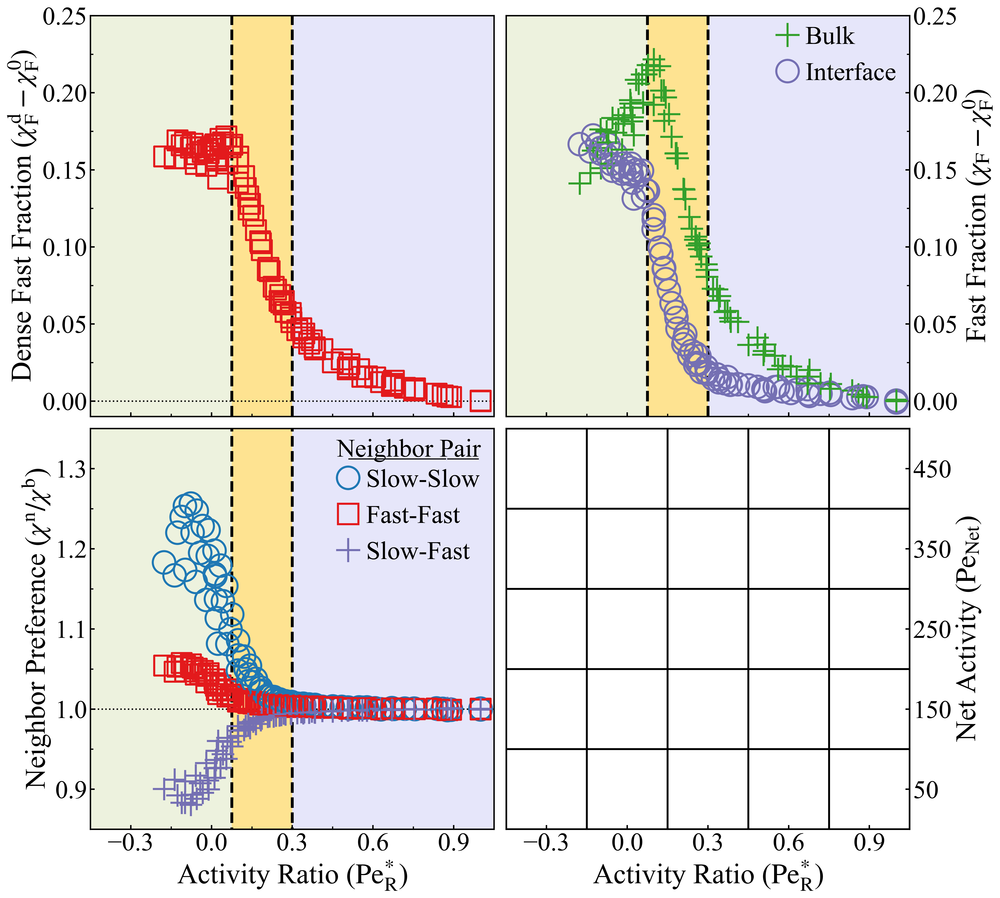

In [13]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres6:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 

# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres6, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new5 = []
os.chdir(parent)
os.chdir('./xa_txt_files/PhaseComp_bins')
for i in pres6:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_pres_new5.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new5[-1])
print(storeVals)

C:\Users\Nick\AppData\Local\Temp\ipykernel_4660\2063958093.py:44: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_4660\2063958093.py:97: UserWarning: You passed a edgecolor/edgecolors ('None') for an unfilled marker ('+').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  ax1[0,1].scatter((interpart_peA[temp_id][i]-45)/(interpart_peB[temp_id][i]-45), ((avg_bulk_NB[temp_id][i])/(avg_bulk_N[temp_id][i]))-(j/100), zorder=count2,  facecolor='#33a02c', edgecolor='None', marker='+', linewidth = 1.8*1.2, s=msz*45*0.7, label='Simulation')
C:\Users\Nick\AppData\Local\Temp\ipykernel_4660\2063958093.py:125: MatplotlibDeprecationWarning: hatch must consist of a stri

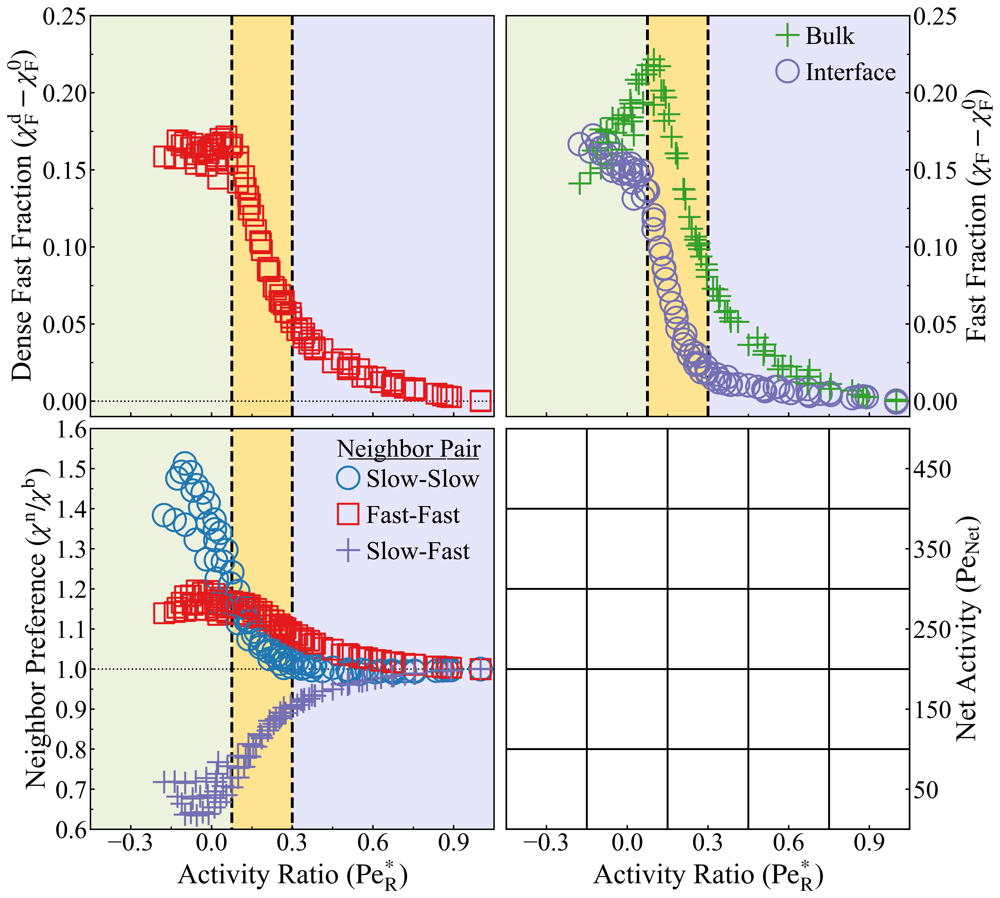

In [16]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params7 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new5)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params7 = params7.append(df, ignore_index = True)
display(params7)

C:\Users\Nick\AppData\Local\Temp\ipykernel_22208\235887389.py:44: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_22208\235887389.py:94: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])
C:\Users\Nick\AppData\Local\Temp\ipykernel_22208\235887389.py:146: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patch

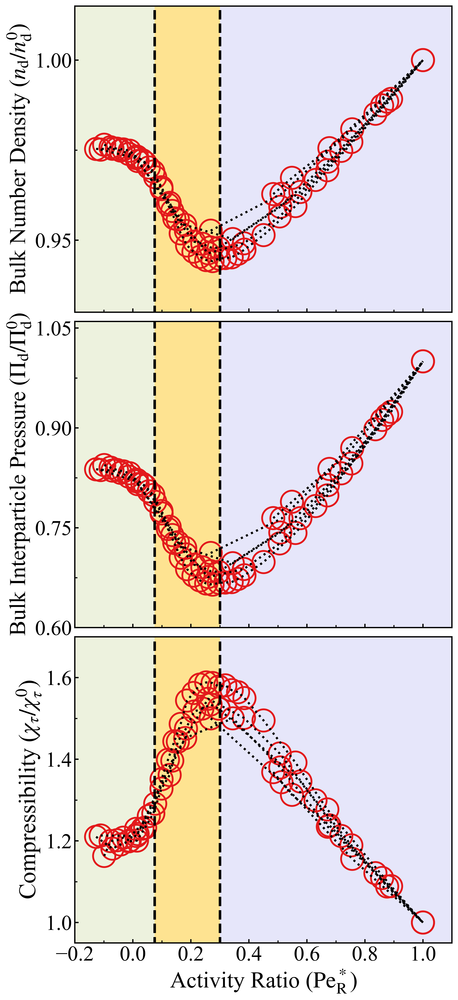

In [217]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new5)):
    # Ger rid of NaN in favor of 0
    all_pres_new5[i].fillna(0, inplace=True)

headers=list(all_pres_new5[0])
display(all_pres_new5[0])
print(all_pres_new5[0][headers[1]][0])
print(all_pres_new5[0][headers[2]][0])

In [ ]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres7:
    print(i)
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 
                
# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres7, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new6 = []
os.chdir(parent)
os.chdir('./xa_txt_files/neighbor')
for i in pres7:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0, on_bad_lines='skip')
    all_pres_new6.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new6[0])


In [ ]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params8 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new6)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params8 = params8.append(df, ignore_index = True)
display(params8)

In [ ]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new6)):
    # Ger rid of NaN in favor of 0
    all_pres_new6[i].fillna(0, inplace=True)

headers=list(all_pres_new6[0])
display(all_pres_new6[0])
print(all_pres_new6[0][headers[1]][0])
print(all_pres_new6[0][headers[2]][0])

In [ ]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres8:
    print(i)
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 
                
# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres8, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new7 = []
os.chdir(parent)
os.chdir('./xa_txt_files/wasserstein')
for i in pres8:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0, on_bad_lines='skip')
    all_pres_new7.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new7[0])

In [ ]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params9 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new7)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params9 = params9.append(df, ignore_index = True)
display(params9)

In [ ]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new7)):
    # Ger rid of NaN in favor of 0
    all_pres_new7[i].fillna(0, inplace=True)

headers=list(all_pres_new7[0])
display(all_pres_new7[0])
print(all_pres_new7[0][headers[1]][0])
print(all_pres_new7[0][headers[2]][0])

In [ ]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres9:
    print(i)
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 
                
# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres9, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new8 = []
os.chdir(parent)
os.chdir('./xa_txt_files/rdf')
for i in pres9:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0, on_bad_lines='skip')
    all_pres_new8.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new8[0])

In [ ]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params10 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new8)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params10 = params10.append(df, ignore_index = True)
display(params10)

In [ ]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new8)):
    # Ger rid of NaN in favor of 0
    all_pres_new8[i].fillna(0, inplace=True)

headers=list(all_pres_new8[0])
display(all_pres_new8[0])
print(all_pres_new8[0][headers[1]][0])
print(all_pres_new8[0][headers[2]][0])

In [ ]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres10:
    print(i)
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 
                
# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres10, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new9 = []
os.chdir(parent)
os.chdir('./xa_txt_files/not_clust_motion')
for i in pres10:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0, on_bad_lines='skip')
    all_pres_new9.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new9[0])

In [ ]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params11 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new9)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params11 = params11.append(df, ignore_index = True)
display(params11)

In [ ]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new9)):
    # Ger rid of NaN in favor of 0
    all_pres_new9[i].fillna(0, inplace=True)

headers=list(all_pres_new9[0])
display(all_pres_new9[0])
print(all_pres_new9[0][headers[1]][0])
print(all_pres_new9[0][headers[2]][0])

In [ ]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres11:
    print(i)
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 
                
# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres11, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new10 = []
os.chdir(parent)
os.chdir('./xa_txt_files/compressibility')
for i in pres11:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0, on_bad_lines='skip')
    all_pres_new10.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new10[0])

In [ ]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params12 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new10)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params12 = params12.append(df, ignore_index = True)
display(params12)

In [ ]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new10)):
    # Ger rid of NaN in favor of 0
    all_pres_new10[i].fillna(0, inplace=True)

headers=list(all_pres_new10[0])
display(all_pres_new10[0])
print(all_pres_new10[0][headers[1]][0])
print(all_pres_new10[0][headers[2]][0])

In [ ]:
def write_to_txt(input_dict, outPath):
    #Output values for radial measurements from CoM
    headers = []
    data = []
    is_file = os.path.isfile(outPath)
    for key, value in input_dict.items():
        if isinstance(value, dict):
            for key2, value2 in value.items():
                if isinstance(value2, dict):
                    for key3, value3 in value2.items():
                        key_new = key + '_' + key2 + '_' + key3
                        headers.append(key_new)
                        data.append(value3)
                else:
                    key_new = key + '_' + key2
                    headers.append(key_new)
                    data.append(value2)
        else:
            headers.append(key)
            data.append(value)
    if is_file == 0:
        header_string = ''
        with open(outPath, 'w+') as f:
            for i in range(0, len(headers)):
                if i == len(headers)-1:
                    header_string += headers[i].center(20) + '\n'
                else:
                    header_string += headers[i].center(20) + ' '
            f.write(header_string)
        arr_ind = 0
        arr_len = 1
        for i in range(0, len(data)):
            if type(data[i])==list:
                arr_len_temp = len(data[i])
                if arr_len_temp > arr_len:
                    arr_len = arr_len_temp
        with open(outPath, 'a') as f:
            while arr_ind < arr_len:
                #print(arr_ind)
                for i in range(0, len(data)):
                    if i == len(data)-1:
                        if type(data[i])==list:
                            f.write('{0:.9f}'.format(data[i][arr_ind]).center(20) + '\n')
                            arr_ind += 1
                        elif (type(data[i])==int) | (type(data[i])==np.uint32):
                            f.write('{0:.0f}'.format(data[i]).center(20) + '\n')
                            arr_ind += 1
                        elif (type(data[i])==float) | (type(data[i])==np.float64) | (type(data[i])==np.float32):
                            f.write('{0:.9f}'.format(data[i]).center(20) + '\n')
                            arr_ind += 1
                        elif type(data[i])==str:
                            f.write('{}'.format(data[i]).center(20) + '\n')
                            arr_ind += 1
                        else:
                            f.write('{0:.9f}'.format(data[i][arr_ind]).center(20) + '\n')
                            arr_ind += 1
                    else:
                        if type(data[i])==list:
                            f.write('{0:.9f}'.format(data[i][arr_ind]).center(20) + ' ')
                        elif (type(data[i])==int) | (type(data[i])==np.uint32):
                            f.write('{0:.0f}'.format(data[i]).center(20) + ' ')
                        elif (type(data[i])==float) | (type(data[i])==np.float64) | (type(data[i])==np.float32):
                            f.write('{0:.9f}'.format(data[i]).center(20) + ' ')
                        elif type(data[i])==str:
                            f.write('{}'.format(data[i]).center(20) + ' ')
                        else:
                            f.write('{0:.6f}'.format(data[i][arr_ind]).center(20) + ' ')
    else:
        arr_ind = 0
        arr_len = 1
        for i in range(0, len(data)):
            if type(data[i])==list:
                arr_len_temp = len(data[i])
                if arr_len_temp > arr_len:
                    arr_len = arr_len_temp
        with open(outPath, 'a') as f:
            while arr_ind < arr_len:
                for i in range(0, len(data)):
                    if i == len(data)-1:
                        if type(data[i])==list:
                            f.write('{0:.9f}'.format(data[i][arr_ind]).center(20) + '\n')
                            arr_ind += 1
                        elif (type(data[i])==int) | (type(data[i])==np.uint32):
                            f.write('{0:.0f}'.format(data[i]).center(20) + '\n')
                            arr_ind += 1
                        elif (type(data[i])==float) | (type(data[i])==np.float64) | (type(data[i])==np.float32):
                            f.write('{0:.9f}'.format(data[i]).center(20) + '\n')
                            arr_ind += 1
                        elif type(data[i])==str:
                            f.write('{}'.format(data[i]).center(20) + '\n')
                            arr_ind += 1
                        else:
                            f.write('{0:.9f}'.format(data[i][arr_ind]).center(20) + '\n')
                            arr_ind += 1
                    else:
                        if type(data[i])==list:
                            f.write('{0:.9f}'.format(data[i][arr_ind]).center(20) + ' ')
                        elif (type(data[i])==int) | (type(data[i])==np.uint32):
                            f.write('{0:.0f}'.format(data[i]).center(20) + ' ')
                        elif (type(data[i])==float) | (type(data[i])==np.float64) | (type(data[i])==np.float32):
                            f.write('{0:.9f}'.format(data[i]).center(20) + ' ')
                        elif type(data[i])==str:
                            f.write('{}'.format(data[i]).center(20) + ' ')
                        else:
                            f.write('{0:.9f}'.format(data[i][arr_ind]).center(20) + ' ')

from scipy.optimize import curve_fit

#fig, ax1 = plt.subplots(figsize=(12,10))
#x_arr = np.array([0, 600])
#y_arr = np.array([1.0, 1.0])
#np.mean(bulk_nB_arr[])top

clust_size_dict = {}
#plt.plot(x_arr, y_arr, c='black',lw=1.8*1.8, ls='--')
def linear_fit(x, A, B):
    y = (A * x + B)
    return y
for k in range(0, len(all_pres)):
    if all_pres[k].empty:
        continue
    for q in range(0, len(all_pres_new2)):

        if all_pres_new2[q].empty:
            continue
        if (params4['peA'][q]==params2['peA'][k]) & (params4['peB'][q]==params2['peB'][k]) & (params4['xA'][q]==params2['xA'][k]):
            
            for t in range(0, len(all_pres_new)):
                if all_pres_new[t].empty:
                        continue
                if (params3['peA'][t]==params2['peA'][k]) & (params3['peB'][t]==params2['peB'][k]) & (params3['xA'][t]==params2['xA'][k]):
                    for u in range(0, len(all_pres_new4)):
                        if all_pres_new4[u].empty:
                            continue
                        if (params6['peA'][u]==params2['peA'][k]) & (params6['peB'][u]==params2['peB'][k]) & (params6['xA'][u]==params2['xA'][k]):
                                for r in range(0, len(all_pres_new5)):
                                    if all_pres_new5[r].empty:
                                        continue
                                    if (params7['peA'][r]==params2['peA'][k]) & (params7['peB'][r]==params2['peB'][k]) & (params7['xA'][r]==params2['xA'][k]):
                                        for v in range(0, len(all_pres_new6)):
                                            if all_pres_new6[v].empty:
                                                continue
                                            if (params8['peA'][v]==params2['peA'][k]) & (params8['peB'][v]==params2['peB'][k]) & (params8['xA'][v]==params2['xA'][k]):
                                                for w in range(0, len(all_pres_new7)):
                                                    if all_pres_new7[w].empty:
                                                        continue
                                                    if (params9['peA'][w]==params2['peA'][k]) & (params9['peB'][w]==params2['peB'][k]) & (params9['xA'][w]==params2['xA'][k]):
                                                        for y in range(0, len(all_pres_new9)):
                                                                    if all_pres_new9[y].empty:
                                                                        continue
                                                                    if (params11['peA'][y]==params2['peA'][k]) & (params11['peB'][y]==params2['peB'][k]) & (params11['xA'][y]==params2['xA'][k]):

                                                                                if (params8['xA'][v]==50):
                                                                                    print(pres5[u])
                                                                                    print(params2['peA'][k])
                                                                                    print(params2['peB'][k])
                                                                                    time_k = all_pres[k]['tauB']
                                                                                    time_q = all_pres_new2[q]['tauB']
                                                                                    time_t = all_pres_new[t]['tauB']
                                                                                    time_u = all_pres_new4[u]['tauB']
                                                                                    time_r = all_pres_new5[r]['tauB']
                                                                                    time_v = all_pres_new6[v]['tauB']
                                                                                    time_w = all_pres_new7[w]['tauB']
                                                                                    #time_x = all_pres_new8[x]['tauB']
                                                                                    time_y = all_pres_new9[y]['tauB']
                                                                                    #time_z = all_pres_new10[z]['tauB']




                                                                                    #Instantiate arrays for reading in interface pressure .txt file
                                                                                    final_time_i =np.array([])
                                                                                    final_align_press_all = np.array([])
                                                                                    final_align_press_A = np.array([])
                                                                                    final_align_press_B = np.array([])
                                                                                    align_press_all_total = 0
                                                                                    align_press_A_total = 0
                                                                                    align_press_B_total = 0
                                                                                    align_press_vals=0

                                                                                    #Instantiate arrays for reading in bulk pressure .txt file
                                                                                    bulk_time =np.array([])
                                                                                    bulk_press_time = np.array([])
                                                                                    bulk_press_total = 0
                                                                                    bulk_allA_press_total = 0
                                                                                    bulk_allB_press_total = 0
                                                                                    bulk_AA_press_total = 0
                                                                                    bulk_AB_press_total = 0
                                                                                    bulk_BA_press_total = 0
                                                                                    bulk_BB_press_total = 0
                                                                                    bulk_press_total_expand = 0
                                                                                    bulk_press_vals=0
                                                                                    shear_press_expand=0

                                                                                    dense_time =np.array([])
                                                                                    dense_press_time = np.array([])
                                                                                    dense_press_total = 0
                                                                                    dense_allA_press_total = 0
                                                                                    dense_allB_press_total = 0
                                                                                    dense_AA_press_total = 0
                                                                                    dense_AB_press_total = 0
                                                                                    dense_BA_press_total = 0
                                                                                    dense_BB_press_total = 0
                                                                                    dense_press_total_expand = 0
                                                                                    dense_press_vals=0
                                                                                    shear_press_expand=0

                                                                                    gas_time =np.array([])
                                                                                    gas_press_time = np.array([])
                                                                                    gas_press_total = 0
                                                                                    gas_allA_press_total = 0
                                                                                    gas_allB_press_total = 0
                                                                                    gas_AA_press_total = 0
                                                                                    gas_AB_press_total = 0
                                                                                    gas_BA_press_total = 0
                                                                                    gas_BB_press_total = 0
                                                                                    gas_press_total_expand = 0
                                                                                    gas_press_vals=0
                                                                                    shear_press_expand=0

                                                                                    #Instantiate arrays for reading in number density .txt file
                                                                                    bulk_nA_arr = np.array([])
                                                                                    bulk_nB_arr = np.array([])
                                                                                    bulk_n_arr = np.array([])
                                                                                    int_n_arr = np.array([])
                                                                                    int_nA_arr = np.array([])
                                                                                    int_nB_arr = np.array([])
                                                                                    gas_nA_arr = np.array([])
                                                                                    gas_n_arr = np.array([])
                                                                                    gas_nB_arr = np.array([])

                                                                                    bulk_NA_arr = np.array([])
                                                                                    bulk_NB_arr = np.array([])
                                                                                    bulk_N_arr = np.array([])
                                                                                    int_N_arr = np.array([])
                                                                                    int_NA_arr = np.array([])
                                                                                    int_NB_arr = np.array([])
                                                                                    gas_NA_arr = np.array([])
                                                                                    gas_N_arr = np.array([])
                                                                                    gas_NB_arr = np.array([])
                                                                                    dense_NA_arr = np.array([])
                                                                                    dense_N_arr = np.array([])
                                                                                    dense_NB_arr = np.array([])

                                                                                    time_local_dens = np.array([])


                                                                                    time_domain = np.array([])

                                                                                    bulk_area_arr = np.array([])
                                                                                    int_area_arr = np.array([])
                                                                                    gas_area_arr = np.array([])

                                                                                    dense_nA_arr = np.array([])
                                                                                    dense_nB_arr = np.array([])
                                                                                    dense_n_arr = np.array([])

                                                                                    #Instantiate arrays for reading in lattice spacing .txt file
                                                                                    bulk_all_lat_mean = np.array([])
                                                                                    bulk_A_lat_mean = np.array([])
                                                                                    bulk_B_lat_mean = np.array([])

                                                                                    bulk_all_lat_std = np.array([])
                                                                                    bulk_A_lat_std = np.array([])
                                                                                    bulk_B_lat_std = np.array([])

                                                                                    #Instantiate arrays for reading in radial measurement .txt file
                                                                                    num_dens_arr_temp = np.zeros(50)
                                                                                    align_arr_temp = np.zeros(50)
                                                                                    press_arr_temp = np.zeros(50)
                                                                                    xA_arr_temp = np.zeros(50)
                                                                                    xB_arr_temp = np.zeros(50)
                                                                                    temp_count = np.zeros(50)
                                                                                    temp_count_count = np.zeros(50)

                                                                                    radius_arr_final = np.linspace(0,1.6,num=50)
                                                                                    num_dens_arr_final = np.zeros(50)
                                                                                    align_arr_final = np.zeros(50)
                                                                                    xA_arr_final = np.zeros(50)
                                                                                    xB_arr_final = np.zeros(50)
                                                                                    press_arr_final = np.zeros(50)
                                                                                    final_count = np.zeros(50)
                                                                                    final_count_count = np.zeros(50)

                                                                                    press_theory_time = np.array([])
                                                                                    press_theory_val = np.array([])
                                                                                    time_arr = np.array([])

                                                                                    bub_width_arr = np.array([])
                                                                                    bub_area_arr = np.array([])
                                                                                    bub_surface_area_arr = np.array([])
                                                                                    int_width_arr = np.array([])
                                                                                    clust_arr = np.array([])

                                                                                    time_dens = np.array([])
                                                                                    time_num_dens = np.array([])
                                                                                    time_width = np.array([])
                                                                                    time_lat = np.array([])

                                                                                    align_arr_temp_sum = 0
                                                                                    align_arr_temp_val = 0

                                                                                    bulk_allall_mean_arr = np.array([])
                                                                                    bulk_allall_std_arr = np.array([])

                                                                                    bulk_allA_mean_arr = np.array([])
                                                                                    bulk_allA_std_arr = np.array([])

                                                                                    bulk_allB_mean_arr = np.array([])
                                                                                    bulk_allB_std_arr = np.array([])

                                                                                    bulk_Aall_mean_arr = np.array([])
                                                                                    bulk_Aall_std_arr = np.array([])

                                                                                    bulk_Ball_mean_arr = np.array([])
                                                                                    bulk_Ball_std_arr = np.array([])

                                                                                    bulk_AA_mean_arr = np.array([])
                                                                                    bulk_AA_std_arr = np.array([])

                                                                                    bulk_AB_mean_arr = np.array([])
                                                                                    bulk_AB_std_arr = np.array([])

                                                                                    bulk_BA_mean_arr = np.array([])
                                                                                    bulk_BA_std_arr = np.array([])

                                                                                    bulk_BB_mean_arr = np.array([])
                                                                                    bulk_BB_std_arr = np.array([])

                                                                                    bulk_prob_allA_mean_arr = np.array([])
                                                                                    bulk_prob_allB_mean_arr = np.array([])

                                                                                    bulk_prob_AA_mean_arr = np.array([])
                                                                                    bulk_prob_AB_mean_arr = np.array([])
                                                                                    bulk_prob_BA_mean_arr = np.array([])
                                                                                    bulk_prob_BB_mean_arr = np.array([])
                                                                                    
                                                                                    int_allall_mean_arr = np.array([])
                                                                                    int_allall_std_arr = np.array([])

                                                                                    int_allA_mean_arr = np.array([])
                                                                                    int_allA_std_arr = np.array([])

                                                                                    int_allB_mean_arr = np.array([])
                                                                                    int_allB_std_arr = np.array([])

                                                                                    int_Aall_mean_arr = np.array([])
                                                                                    int_Aall_std_arr = np.array([])

                                                                                    int_Ball_mean_arr = np.array([])
                                                                                    int_Ball_std_arr = np.array([])

                                                                                    int_AA_mean_arr = np.array([])
                                                                                    int_AA_std_arr = np.array([])

                                                                                    int_AB_mean_arr = np.array([])
                                                                                    int_AB_std_arr = np.array([])

                                                                                    int_BA_mean_arr = np.array([])
                                                                                    int_BA_std_arr = np.array([])

                                                                                    int_BB_mean_arr = np.array([])
                                                                                    int_BB_std_arr = np.array([])

                                                                                    int_prob_allA_mean_arr = np.array([])
                                                                                    int_prob_allB_mean_arr = np.array([])

                                                                                    int_prob_AA_mean_arr = np.array([])
                                                                                    int_prob_AB_mean_arr = np.array([])
                                                                                    int_prob_BA_mean_arr = np.array([])
                                                                                    int_prob_BB_mean_arr = np.array([])
                                                                                    
                                                                                    dense_allall_mean_arr = np.array([])
                                                                                    dense_allall_std_arr = np.array([])

                                                                                    dense_allA_mean_arr = np.array([])
                                                                                    dense_allA_std_arr = np.array([])

                                                                                    dense_allB_mean_arr = np.array([])
                                                                                    dense_allB_std_arr = np.array([])

                                                                                    dense_Aall_mean_arr = np.array([])
                                                                                    dense_Aall_std_arr = np.array([])

                                                                                    dense_Ball_mean_arr = np.array([])
                                                                                    dense_Ball_std_arr = np.array([])

                                                                                    dense_AA_mean_arr = np.array([])
                                                                                    dense_AA_std_arr = np.array([])

                                                                                    dense_AB_mean_arr = np.array([])
                                                                                    dense_AB_std_arr = np.array([])

                                                                                    dense_BA_mean_arr = np.array([])
                                                                                    dense_BA_std_arr = np.array([])

                                                                                    dense_BB_mean_arr = np.array([])
                                                                                    dense_BB_std_arr = np.array([])

                                                                                    dense_prob_allA_mean_arr = np.array([])
                                                                                    dense_prob_allB_mean_arr = np.array([])

                                                                                    dense_prob_AA_mean_arr = np.array([])
                                                                                    dense_prob_AB_mean_arr = np.array([])
                                                                                    dense_prob_BA_mean_arr = np.array([])
                                                                                    dense_prob_BB_mean_arr = np.array([])
                                                                                    
                                                                                    time_bulk = np.array([])
                                                                                    time_com_press = np.array([])
                                                                                    com_int_press_all = np.array([])
                                                                                    com_int_press_A = np.array([])
                                                                                    com_int_press_B = np.array([])


                                                                                    bulk_fast_frac = np.array([])
                                                                                    bulk_slow_frac = np.array([])
                                                                                    
                                                                                    int_fast_frac = np.array([])
                                                                                    int_slow_frac = np.array([])
                                                                                    
                                                                                    dense_fast_frac = np.array([])
                                                                                    dense_slow_frac = np.array([])

                                                                                    bulk_press_time_final = np.array([])
                                                                                    bulk_allA_press_time_final = np.array([])
                                                                                    bulk_allB_press_time_final = np.array([])
                                                                                    bulk_n_arr_final = np.array([])
                                                                                    bulk_nA_arr_final = np.array([])
                                                                                    bulk_nB_arr_final = np.array([])
                                                                                    bulk_rad_arr_final = np.array([])

                                                                                    time_com_press = np.array([])
                                                                                    com_int_press_all = np.array([])
                                                                                    com_int_press_A = np.array([])
                                                                                    com_int_press_B = np.array([])

                                                                                    time_surface_press = np.array([])
                                                                                    surface_int_press_all = np.array([])
                                                                                    surface_int_press_A = np.array([])
                                                                                    surface_int_press_B = np.array([])
                                                                                    
                                                                                    no_desorb_x = np.array([])
                                                                                    no_desorb_y = np.array([])
                                                                                    no_desorb_r = np.array([])
                                                                                    net_flux_x = np.array([])
                                                                                    net_flux_y = np.array([])
                                                                                    net_flux_r = np.array([])
                                                                                    total_x = np.array([])
                                                                                    total_y = np.array([])
                                                                                    total_r = np.array([])
                                                                                    com_flux_x = np.array([])
                                                                                    com_flux_y = np.array([])
                                                                                    com_flux_r = np.array([])
                                                                                    align = np.array([])
                                                                                    magnitude = np.array([])
                                                                                    dif_x_arr = np.array([])
                                                                                    dif_y_arr = np.array([])
                                                                                    dif_r_arr = np.array([])
                                                                                    time_vel = np.array([])

                                                                                    time_comp = np.array([])
                                                                                    compress_all_all = np.array([])
                                                                                    compress_all_A = np.array([])
                                                                                    compress_all_B = np.array([])
                                                                                    
                                                                                    time_wass = np.array([])
                                                                                    wass_AA_BB = np.array([])
                                                                                    wass_AB_BB = np.array([])
                                                                                    wass_allA_allB = np.array([])
                                                                                    wass_allA_AA = np.array([])
                                                                                    wass_allB_BB = np.array([])



                                                                                    num_dens_arr_temp_sum = 0
                                                                                    #Loop over time in interface pressure .txt file
                                                                                    for j in range(0, len(time_k)):

                                                                                        #Current time in loop
                                                                                        time = time_k[j]
                                                                                        if time >=100:

                                                                                            #Read values and set variables from bulk pressure.txt files

                                                                                            time_id_k=j

                                                                                            #bulk_trace = (all_pres[k]['bulkSigXX'].iloc[time_id_k]+all_pres[k]['bulkSigYY'].iloc[time_id_k])/2


                                                                                            bulk_press = all_pres[k]['all-all_bulk_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            bulk_allA_press = all_pres[k]['all-A_bulk_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            bulk_allB_press = all_pres[k]['all-B_bulk_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            bulk_AA_press = all_pres[k]['A-A_bulk_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            bulk_AB_press = all_pres[k]['A-B_bulk_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            bulk_BB_press = all_pres[k]['B-B_bulk_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])

                                                                                            dense_press = all_pres[k]['all-all_dense_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            dense_allA_press = all_pres[k]['all-A_dense_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            dense_allB_press = all_pres[k]['all-B_dense_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            dense_AA_press = all_pres[k]['A-A_dense_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            dense_AB_press = all_pres[k]['A-B_dense_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            dense_BB_press = all_pres[k]['B-B_dense_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])

                                                                                            gas_press = all_pres[k]['all-all_gas_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            gas_allA_press = all_pres[k]['all-A_gas_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            gas_allB_press = all_pres[k]['all-B_gas_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            gas_AA_press = all_pres[k]['A-A_gas_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            gas_AB_press = all_pres[k]['A-B_gas_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            gas_BB_press = all_pres[k]['B-B_gas_press'].iloc[time_id_k] # bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])

                                                                                            #bulk_trace_expand = (all_pres[k]['bulkSigXX'].iloc[time_id_k]+all_pres[k]['bulkSigXY'].iloc[time_id_k]+all_pres[k]['bulkSigYX'].iloc[time_id_k]+all_pres[k]['bulkSigYY'].iloc[time_id_k])/2
                                                                                            #bulk_press_expand = bulk_trace_expand / (all_pres[k]['bulkArea'].iloc[time_id_k])

                                                                                            #shear_stress = (all_pres[k]['bulkSigXY'].iloc[time_id_k]+all_pres[k]['bulkSigYX'].iloc[time_id_k])/2
                                                                                            #shear_press = shear_stress / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                            if bulk_press>0:
                                                                                                bulk_time = np.append(bulk_time, all_pres[k]['tauB'].iloc[time_id_k])
                                                                                                #bulk_press_time = np.append(bulk_press_time, bulk_press/2)


                                                                                                #bulk_press_time = np.append(bulk_press_time, all_pres[k]['all-all_bulk_press'].iloc[time_id_k])
                                                                                                #shear_press_expand +=shear_press
                                                                                                if math.isnan(bulk_press)==0:

                                                                                                    bulk_press_time = np.append(bulk_press_time, bulk_press)
                                                                                                    dense_press_time = np.append(dense_press_time, dense_press)
                                                                                                    gas_press_time = np.append(gas_press_time, gas_press)

                                                                                                    if all_pres[k]['tauB'].iloc[time_id_k] >= 100:
                                                                                                        bulk_press_total += bulk_press
                                                                                                        bulk_allA_press_total += bulk_allA_press
                                                                                                        bulk_allB_press_total += bulk_allB_press
                                                                                                        bulk_AA_press_total += bulk_AA_press
                                                                                                        bulk_AB_press_total += bulk_AB_press
                                                                                                        bulk_BB_press_total += bulk_BB_press



                                                                                                        #bulk_press_time = np.append(bulk_press_time, all_pres[k]['all-all_bulk_press'].iloc[time_id_k])
                                                                                                        #shear_press_expand +=shear_press
                                                                                                        dense_press_total += dense_press
                                                                                                        dense_allA_press_total += dense_allA_press
                                                                                                        dense_allB_press_total += dense_allB_press
                                                                                                        dense_AA_press_total += dense_AA_press
                                                                                                        dense_AB_press_total += dense_AB_press
                                                                                                        dense_BB_press_total += dense_BB_press



                                                                                                        #bulk_press_time = np.append(bulk_press_time, all_pres[k]['all-all_bulk_press'].iloc[time_id_k])
                                                                                                        #shear_press_expand +=shear_press
                                                                                                        gas_press_total += gas_press
                                                                                                        gas_allA_press_total += gas_allA_press
                                                                                                        gas_allB_press_total += gas_allB_press
                                                                                                        gas_AA_press_total += gas_AA_press
                                                                                                        gas_AB_press_total += gas_AB_press
                                                                                                        gas_BB_press_total += gas_BB_press

                                                                                                        #bulk_press_total_expand += bulk_press_expand
                                                                                                        bulk_press_vals += 1

                                                                                            #Read values and set variables from number density .txt files
                                                                                            time_id_q = np.where(time_q==time)[0]
                                                                                            time_id_r = np.where(time_r==time)[0]

                                                                                            if len(time_id_q)>0:
                                                                                                time_dens = np.append(time_dens, time)
                                                                                                bin_size = all_pres_new5[r]['sizeBin_x'][time_id_r]
                                                                                                bin_area = bin_size**2

                                                                                                if math.isnan(all_pres_new2[q]['bulk_all'][time_id_q].values[0])==0:

                                                                                                    if (all_pres_new5[r]['bulk'][time_id_r].values[0])>0:
                                                                                                        bulk_NA_arr = np.append(bulk_NA_arr, all_pres_new2[q]['bulk_A'][time_id_q].values[0])
                                                                                                        bulk_NB_arr = np.append(bulk_NB_arr, all_pres_new2[q]['bulk_B'][time_id_q].values[0])
                                                                                                        bulk_N_arr = np.append(bulk_N_arr, all_pres_new2[q]['bulk_all'][time_id_q].values[0])

                                                                                                        bulk_area_arr = np.append(bulk_area_arr, (bin_area * all_pres_new5[r]['bulk'][time_id_r].values[0]))


                                                                                                        bulk_nA_arr = np.append(bulk_nA_arr, all_pres_new2[q]['bulk_A'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['bulk'][time_id_r].values[0]))
                                                                                                        bulk_nB_arr = np.append(bulk_nB_arr, all_pres_new2[q]['bulk_B'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['bulk'][time_id_r].values[0]))
                                                                                                        bulk_n_arr = np.append(bulk_n_arr, (all_pres_new2[q]['bulk_all'][time_id_q].values[0]) / (bin_area * all_pres_new5[r]['bulk'][time_id_r].values[0]))
                                                                                                        bulk_fast_frac_val = (bulk_nB_arr[-1]/bulk_n_arr[-1])
                                                                                                        bulk_slow_frac_val = (bulk_nA_arr[-1]/bulk_n_arr[-1])

                                                                                                        int_NA_arr = np.append(int_NA_arr, all_pres_new2[q]['int_A'][time_id_q].values[0])
                                                                                                        int_NB_arr = np.append(int_NB_arr, all_pres_new2[q]['int_B'][time_id_q].values[0])
                                                                                                        int_N_arr = np.append(int_N_arr, all_pres_new2[q]['int_all'][time_id_q].values[0])

                                                                                                        int_area_arr = np.append(int_area_arr, (bin_area * all_pres_new5[r]['int'][time_id_r].values[0]))

                                                                                                        int_n_arr = np.append(int_n_arr, (all_pres_new2[q]['int_all'][time_id_q].values[0]) / (bin_area * all_pres_new5[r]['int'][time_id_r].values[0]))
                                                                                                        int_nA_arr = np.append(int_nA_arr, all_pres_new2[q]['int_A'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['int'][time_id_r].values[0]))
                                                                                                        int_nB_arr = np.append(int_nB_arr, all_pres_new2[q]['int_B'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['int'][time_id_r].values[0]))
                                                                                                        
                                                                                                        int_fast_frac_val = (int_nB_arr[-1]/int_n_arr[-1])
                                                                                                        int_slow_frac_val = (int_nA_arr[-1]/int_n_arr[-1])

                                                                                                        gas_NA_arr = np.append(gas_NA_arr, all_pres_new2[q]['gas_A'][time_id_q].values[0])
                                                                                                        gas_NB_arr = np.append(gas_NB_arr, all_pres_new2[q]['gas_B'][time_id_q].values[0])
                                                                                                        gas_N_arr = np.append(gas_N_arr, all_pres_new2[q]['gas_all'][time_id_q].values[0])

                                                                                                        gas_area_arr = np.append(gas_area_arr, (bin_area * all_pres_new5[r]['gas'][time_id_r].values[0]))

                                                                                                        gas_n_arr = np.append(gas_n_arr, (all_pres_new2[q]['gas_all'][time_id_q].values[0]) / (bin_area * all_pres_new5[r]['gas'][time_id_r].values[0]))
                                                                                                        gas_nA_arr = np.append(gas_nA_arr, all_pres_new2[q]['gas_A'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['gas'][time_id_r].values[0]))
                                                                                                        gas_nB_arr = np.append(gas_nB_arr, all_pres_new2[q]['gas_B'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['gas'][time_id_r].values[0]))

                                                                                                        dense_n_arr = np.append(dense_n_arr, (all_pres_new2[q]['int_all'][time_id_q].values[0]+all_pres_new2[q]['bulk_all'][time_id_q].values[0]) / (bin_area * (all_pres_new5[r]['int'][time_id_r].values[0]+all_pres_new5[r]['bulk'][time_id_r].values[0])))
                                                                                                        dense_nA_arr = np.append(dense_nA_arr, (all_pres_new2[q]['int_A'][time_id_q].values[0]+all_pres_new2[q]['bulk_A'][time_id_q].values[0]) / (bin_area * (all_pres_new5[r]['int'][time_id_r].values[0]+all_pres_new5[r]['bulk'][time_id_r].values[0])))
                                                                                                        dense_nB_arr = np.append(dense_nB_arr, (all_pres_new2[q]['int_B'][time_id_q].values[0]+all_pres_new2[q]['bulk_B'][time_id_q].values[0]) / (bin_area * (all_pres_new5[r]['int'][time_id_r].values[0]+all_pres_new5[r]['bulk'][time_id_r].values[0])))

                                                                                                        dense_N_arr = np.append(dense_N_arr, (all_pres_new2[q]['int_all'][time_id_q].values[0]+all_pres_new2[q]['bulk_all'][time_id_q].values[0]))
                                                                                                        dense_NA_arr = np.append(dense_NA_arr, (all_pres_new2[q]['int_A'][time_id_q].values[0]+all_pres_new2[q]['bulk_A'][time_id_q].values[0]))
                                                                                                        dense_NB_arr = np.append(dense_NB_arr, (all_pres_new2[q]['int_B'][time_id_q].values[0]+all_pres_new2[q]['bulk_B'][time_id_q].values[0]))
                                                                                                        
                                                                                                        dense_fast_frac_val = (dense_nB_arr[-1]/dense_n_arr[-1])
                                                                                                        dense_slow_frac_val = (dense_nA_arr[-1]/dense_n_arr[-1])

                                                                                                        time_num_dens = np.append(time_num_dens, time)

                                                                                            time_id_u = np.where(time_u==time)[0]
                                                                                            if len(time_id_u)>0:
                                                                                                time_id_u = time_id_u[0]

                                                                                                if math.isnan(all_pres_new4[u]['bulk_all_mean'][time_id_u])==0:
                                                                                                    bulk_all_lat_mean = np.append(bulk_all_lat_mean, all_pres_new4[u]['bulk_all_mean'][time_id_u])
                                                                                                    bulk_A_lat_mean = np.append(bulk_A_lat_mean, all_pres_new4[u]['bulk_A_mean'][time_id_u])
                                                                                                    bulk_B_lat_mean = np.append(bulk_B_lat_mean, all_pres_new4[u]['bulk_B_mean'][time_id_u])
                                                                                                    bulk_all_lat_std = np.append(bulk_all_lat_std, all_pres_new4[u]['bulk_all_std'][time_id_u])
                                                                                                    bulk_A_lat_std = np.append(bulk_A_lat_std, all_pres_new4[u]['bulk_A_std'][time_id_u])
                                                                                                    bulk_B_lat_std = np.append(bulk_B_lat_std, all_pres_new4[u]['bulk_B_std'][time_id_u])
                                                                                                    time_lat = np.append(time_lat, time)


                                                                                            #Read values and set variables from radial measurement .txt files
                                                                                            time_id_t = np.where(time_t==time)[0]

                                                                                            if (len(time_id_q)>0) & (len(time_id_t)>0) & (len(time_id_r)>0):

                                                                                                if (math.isnan(bulk_press)==0) & (math.isnan(all_pres_new5[r]['bulk'][time_id_r].values[0])==0) & (math.isnan(all_pres_new2[q]['bulk_all'][time_id_q].values[0])==0) & (all_pres_new5[r]['bulk'][time_id_r].values[0]>0):

                                                                                                    bulk_press_time_final = np.append(bulk_press_time_final, bulk_press)

                                                                                                    bulk_n_arr_final = np.append(bulk_n_arr_final, (all_pres_new2[q]['bulk_all'][time_id_q].values[0]) / (bin_area * all_pres_new5[r]['bulk'][time_id_r].values[0]))

                                                                                            max_size = np.amax(all_pres_new[t]['clust_size'])
                                                                                            if len(time_id_t)>0:


                                                                                                time_width = np.append(time_width, time)

                                                                                                bub_width_arr = np.append(bub_width_arr, all_pres_new[t]['ext_mean_rad'][time_id_t])
                                                                                                bub_surface_area_arr = np.append(bub_surface_area_arr, np.max(all_pres_new[t]['ext_sa'][time_id_t]))
                                                                                                int_width_arr = np.append(int_width_arr, all_pres_new[t]['width'][time_id_t])
                                                                                                clust_arr = np.append(clust_arr, all_pres_new[t]['clust_size'][time_id_t])
                                                                                                avg_rad_temp = np.mean(bub_width_arr)

                                                                                            time_id_v = np.where(time_v == time)[0]
                                                                                            if len(time_id_v)>0:
                                                                                                if fast_frac_val > 0:

                                                                                                    time_id_v = time_id_v[0]

                                                                                                    if math.isnan(all_pres_new6[v]['bulk_all-all_mean'][time_id_v])==0:

                                                                                                        time_bulk = np.append(time_bulk, time_v[time_id_v])
                                                                                                        bulk_allall_mean_arr = np.append(bulk_allall_mean_arr, all_pres_new6[v]['bulk_all-all_mean'][time_id_v])
                                                                                                        bulk_allall_std_arr = np.append(bulk_allall_std_arr, all_pres_new6[v]['bulk_all-all_std'][time_id_v])

                                                                                                        bulk_allA_mean_arr = np.append(bulk_allA_mean_arr, all_pres_new6[v]['bulk_all-A_mean'][time_id_v])
                                                                                                        bulk_allA_std_arr = np.append(bulk_allA_std_arr, all_pres_new6[v]['bulk_all-A_std'][time_id_v])

                                                                                                        bulk_allB_mean_arr = np.append(bulk_allB_mean_arr, all_pres_new6[v]['bulk_all-B_mean'][time_id_v])
                                                                                                        bulk_allB_std_arr = np.append(bulk_allB_std_arr, all_pres_new6[v]['bulk_all-B_std'][time_id_v])

                                                                                                        bulk_AA_mean_arr = np.append(bulk_AA_mean_arr, all_pres_new6[v]['bulk_A-A_mean'][time_id_v])
                                                                                                        bulk_AA_std_arr = np.append(bulk_AA_std_arr, all_pres_new6[v]['bulk_A-A_std'][time_id_v])

                                                                                                        bulk_AB_mean_arr = np.append(bulk_AB_mean_arr, all_pres_new6[v]['bulk_A-B_mean'][time_id_v])
                                                                                                        bulk_AB_std_arr = np.append(bulk_AB_std_arr, all_pres_new6[v]['bulk_A-B_std'][time_id_v])

                                                                                                        bulk_BB_mean_arr = np.append(bulk_BB_mean_arr, all_pres_new6[v]['bulk_B-B_mean'][time_id_v])
                                                                                                        bulk_BB_std_arr = np.append(bulk_BB_std_arr, all_pres_new6[v]['bulk_B-B_std'][time_id_v])
                                                                                                        
                                                                                                        int_allall_mean_arr = np.append(int_allall_mean_arr, all_pres_new6[v]['int_all-all_mean'][time_id_v])
                                                                                                        int_allall_std_arr = np.append(int_allall_std_arr, all_pres_new6[v]['int_all-all_std'][time_id_v])

                                                                                                        int_allA_mean_arr = np.append(int_allA_mean_arr, all_pres_new6[v]['int_all-A_mean'][time_id_v])
                                                                                                        int_allA_std_arr = np.append(int_allA_std_arr, all_pres_new6[v]['int_all-A_std'][time_id_v])

                                                                                                        int_allB_mean_arr = np.append(int_allB_mean_arr, all_pres_new6[v]['int_all-B_mean'][time_id_v])
                                                                                                        int_allB_std_arr = np.append(int_allB_std_arr, all_pres_new6[v]['int_all-B_std'][time_id_v])

                                                                                                        int_AA_mean_arr = np.append(int_AA_mean_arr, all_pres_new6[v]['int_A-A_mean'][time_id_v])
                                                                                                        int_AA_std_arr = np.append(int_AA_std_arr, all_pres_new6[v]['int_A-A_std'][time_id_v])

                                                                                                        int_AB_mean_arr = np.append(int_AB_mean_arr, all_pres_new6[v]['int_A-B_mean'][time_id_v])
                                                                                                        int_AB_std_arr = np.append(int_AB_std_arr, all_pres_new6[v]['int_A-B_std'][time_id_v])

                                                                                                        int_BB_mean_arr = np.append(int_BB_mean_arr, all_pres_new6[v]['int_B-B_mean'][time_id_v])
                                                                                                        int_BB_std_arr = np.append(int_BB_std_arr, all_pres_new6[v]['int_B-B_std'][time_id_v])
                                                                                                        
                                                                                                        dense_allall_mean_arr = np.append(dense_allall_mean_arr, all_pres_new6[v]['dense_all-all_mean'][time_id_v])
                                                                                                        dense_allall_std_arr = np.append(dense_allall_std_arr, all_pres_new6[v]['dense_all-all_std'][time_id_v])

                                                                                                        dense_allA_mean_arr = np.append(dense_allA_mean_arr, all_pres_new6[v]['dense_all-A_mean'][time_id_v])
                                                                                                        dense_allA_std_arr = np.append(dense_allA_std_arr, all_pres_new6[v]['dense_all-A_std'][time_id_v])

                                                                                                        dense_allB_mean_arr = np.append(dense_allB_mean_arr, all_pres_new6[v]['dense_all-B_mean'][time_id_v])
                                                                                                        dense_allB_std_arr = np.append(dense_allB_std_arr, all_pres_new6[v]['dense_all-B_std'][time_id_v])

                                                                                                        dense_AA_mean_arr = np.append(dense_AA_mean_arr, all_pres_new6[v]['dense_A-A_mean'][time_id_v])
                                                                                                        dense_AA_std_arr = np.append(dense_AA_std_arr, all_pres_new6[v]['dense_A-A_std'][time_id_v])

                                                                                                        dense_AB_mean_arr = np.append(dense_AB_mean_arr, all_pres_new6[v]['dense_A-B_mean'][time_id_v])
                                                                                                        dense_AB_std_arr = np.append(dense_AB_std_arr, all_pres_new6[v]['dense_A-B_std'][time_id_v])

                                                                                                        dense_BB_mean_arr = np.append(dense_BB_mean_arr, all_pres_new6[v]['dense_B-B_mean'][time_id_v])
                                                                                                        dense_BB_std_arr = np.append(dense_BB_std_arr, all_pres_new6[v]['dense_B-B_std'][time_id_v])
                                                                                                        
                                                                                                        bulk_prob_allA_mean_arr = np.append(bulk_prob_allA_mean_arr, (all_pres_new6[v]['bulk_all-A_mean'][time_id_v]/bulk_slow_frac_val))
                                                                                                        bulk_prob_allB_mean_arr = np.append(bulk_prob_allB_mean_arr, (all_pres_new6[v]['bulk_all-B_mean'][time_id_v]/bulk_fast_frac_val))

                                                                                                        bulk_prob_AA_mean_arr = np.append(bulk_prob_AA_mean_arr, (all_pres_new6[v]['bulk_A-A_mean'][time_id_v]/bulk_slow_frac_val))
                                                                                                        bulk_prob_AB_mean_arr = np.append(bulk_prob_AB_mean_arr, (all_pres_new6[v]['bulk_A-B_mean'][time_id_v]/bulk_fast_frac_val))
                                                                                                        bulk_prob_BB_mean_arr = np.append(bulk_prob_BB_mean_arr, (all_pres_new6[v]['bulk_B-B_mean'][time_id_v]/bulk_fast_frac_val))
                                                                                                        bulk_prob_BA_mean_arr = np.append(bulk_prob_BA_mean_arr, ((all_pres_new6[v]['bulk_all-A_mean'][time_id_v]-all_pres_new6[v]['bulk_A-A_mean'][time_id_v])/bulk_slow_frac_val))
                                                                                                        
                                                                                                        int_prob_allA_mean_arr = np.append(int_prob_allA_mean_arr, (all_pres_new6[v]['int_all-A_mean'][time_id_v]/int_slow_frac_val))
                                                                                                        int_prob_allB_mean_arr = np.append(int_prob_allB_mean_arr, (all_pres_new6[v]['int_all-B_mean'][time_id_v]/int_fast_frac_val))

                                                                                                        int_prob_AA_mean_arr = np.append(int_prob_AA_mean_arr, (all_pres_new6[v]['int_A-A_mean'][time_id_v]/int_slow_frac_val))
                                                                                                        int_prob_AB_mean_arr = np.append(int_prob_AB_mean_arr, (all_pres_new6[v]['int_A-B_mean'][time_id_v]/int_fast_frac_val))
                                                                                                        int_prob_BB_mean_arr = np.append(int_prob_BB_mean_arr, (all_pres_new6[v]['int_B-B_mean'][time_id_v]/int_fast_frac_val))
                                                                                                        int_prob_BA_mean_arr = np.append(int_prob_BA_mean_arr, ((all_pres_new6[v]['int_all-A_mean'][time_id_v]-all_pres_new6[v]['int_A-A_mean'][time_id_v])/int_slow_frac_val))
                                                                                                        
                                                                                                        dense_prob_allA_mean_arr = np.append(int_prob_allA_mean_arr, (all_pres_new6[v]['int_all-A_mean'][time_id_v]/int_slow_frac_val))
                                                                                                        dense_prob_allB_mean_arr = np.append(int_prob_allB_mean_arr, (all_pres_new6[v]['int_all-B_mean'][time_id_v]/int_fast_frac_val))

                                                                                                        dense_prob_AA_mean_arr = np.append(dense_prob_AA_mean_arr, (all_pres_new6[v]['dense_A-A_mean'][time_id_v]/dense_slow_frac_val))
                                                                                                        dense_prob_AB_mean_arr = np.append(dense_prob_AB_mean_arr, (all_pres_new6[v]['dense_A-B_mean'][time_id_v]/dense_fast_frac_val))
                                                                                                        dense_prob_BB_mean_arr = np.append(dense_prob_BB_mean_arr, (all_pres_new6[v]['dense_B-B_mean'][time_id_v]/dense_fast_frac_val))
                                                                                                        dense_prob_BA_mean_arr = np.append(dense_prob_BA_mean_arr, ((all_pres_new6[v]['dense_all-A_mean'][time_id_v]-all_pres_new6[v]['dense_A-A_mean'][time_id_v])/dense_slow_frac_val))
                                                                                                        
                                                                                                        bulk_fast_frac = np.append(bulk_fast_frac, bulk_fast_frac_val)
                                                                                                        bulk_slow_frac = np.append(bulk_slow_frac, bulk_slow_frac_val)
                                                                                                        
                                                                                                        int_fast_frac = np.append(int_fast_frac, int_fast_frac_val)
                                                                                                        int_slow_frac = np.append(int_slow_frac, int_slow_frac_val)
                                                                                                        
                                                                                                        dense_fast_frac = np.append(dense_fast_frac, dense_fast_frac_val)
                                                                                                        dense_slow_frac = np.append(dense_slow_frac, dense_slow_frac_val)

                                                                                            time_id_w = np.where(time_w==time)[0]
                                                                                            if len(time_id_w)>0:
                                                                                                time_wass = np.append(time_wass, time_w[time_id_w])
                                                                                                wass_AA_BB = np.append(wass_AA_BB, all_pres_new7[w]['AA-BB'][time_id_w])
                                                                                                wass_AB_BB = np.append(wass_AB_BB, all_pres_new7[w]['AB-BB'][time_id_w])
                                                                                                wass_allA_allB = np.append(wass_allA_allB, all_pres_new7[w]['allA-allB'][time_id_w])
                                                                                                wass_allA_AA = np.append(wass_allA_AA, all_pres_new7[w]['allA-AA'][time_id_w])
                                                                                                wass_allB_BB = np.append(wass_allB_BB, all_pres_new7[w]['allB-BB'][time_id_w])
                                                                                            
                                                                                            time_id_y = np.where(time_y==time)[0]
                                                                                            if len(time_id_y)>0:
                                                                                                time_vel = np.append(time_vel, time_y[time_id_y])
                                                                                                no_desorb_x = np.append(no_desorb_x, all_pres_new9[y]['no_desorb_x'][time_id_y])
                                                                                                no_desorb_y = np.append(no_desorb_y, all_pres_new9[y]['no_desorb_y'][time_id_y])
                                                                                                no_desorb_r = np.append(no_desorb_r, all_pres_new9[y]['no_desorb_r'][time_id_y])
                                                                                                net_flux_x = np.append(net_flux_x, all_pres_new9[y]['net_flux_x'][time_id_y])
                                                                                                net_flux_y = np.append(net_flux_y, all_pres_new9[y]['net_flux_y'][time_id_y])
                                                                                                net_flux_r = np.append(net_flux_r, all_pres_new9[y]['net_flux_r'][time_id_y])
                                                                                                total_x = np.append(total_x, all_pres_new9[y]['total_x'][time_id_y])
                                                                                                total_y = np.append(total_y, all_pres_new9[y]['total_y'][time_id_y])
                                                                                                total_r = np.append(total_r, all_pres_new9[y]['total_r'][time_id_y])
                                                                                                com_flux_x = np.append(com_flux_x, all_pres_new9[y]['com_flux_x'][time_id_y])
                                                                                                com_flux_y = np.append(com_flux_y, all_pres_new9[y]['com_flux_y'][time_id_y])
                                                                                                com_flux_r = np.append(com_flux_r, all_pres_new9[y]['com_flux_r'][time_id_y])
                                                                                                align = np.append(align, all_pres_new9[y]['align'][time_id_y])
                                                                                                magnitude = np.append(magnitude, all_pres_new9[y]['magnitude'][time_id_y])
                                                                                                dif_x_arr = np.append(dif_x_arr, net_flux_x[-1] - total_x[-1])
                                                                                                dif_y_arr = np.append(dif_y_arr, net_flux_y[-1] - total_y[-1])
                                                                                                dif_r_arr = np.append(dif_r_arr, (dif_x_arr[-1]**2 + dif_y_arr[-1]**2) ** 0.5)
                                                                                            
                                                                                            """time_id_z = np.where(time_z==time)[0]
                                                                                            if len(time_id_z)>0:
                                                                                                time_comp = np.append(time_comp, time_z[time_id_z])
                                                                                                compress_all_all = np.append(compress_all_all, all_pres_new10[z]['compress_all-all'][time_id_w])
                                                                                                compress_all_A = np.append(compress_all_A, all_pres_new10[z]['compress_all-A'][time_id_w])
                                                                                                compress_all_B = np.append(compress_all_B, all_pres_new10[z]['compress_all-B'][time_id_w])"""

                                                                                    #Time-average values for sufficiently long interface pressure .txt files

                                                                                    if bulk_press_vals >= 50: 
                                                                                        neigh_id = np.where(time_bulk>=100)[0]

                                                                                        bulk_allall_mean = np.mean(bulk_allall_mean_arr[neigh_id])
                                                                                        bulk_AA_mean = np.mean(bulk_AA_mean_arr[neigh_id])
                                                                                        bulk_AB_mean = np.mean(bulk_AB_mean_arr[neigh_id])
                                                                                        bulk_BB_mean = np.mean(bulk_BB_mean_arr[neigh_id])
                                                                                        bulk_allB_mean = np.mean(bulk_allB_mean_arr[neigh_id])
                                                                                        bulk_allA_mean = np.mean(bulk_allA_mean_arr[neigh_id])
                                                                                        bulk_BA_mean = (bulk_allA_mean-bulk_AA_mean)


                                                                                        bulk_chi_f_avg = np.mean(bulk_fast_frac[neigh_id])
                                                                                        bulk_chi_s_avg = np.mean(bulk_slow_frac[neigh_id])
                                                                                        
                                                                                        int_allall_mean = np.mean(int_allall_mean_arr[neigh_id])
                                                                                        int_AA_mean = np.mean(int_AA_mean_arr[neigh_id])
                                                                                        int_AB_mean = np.mean(int_AB_mean_arr[neigh_id])
                                                                                        int_BB_mean = np.mean(int_BB_mean_arr[neigh_id])
                                                                                        int_allB_mean = np.mean(int_allB_mean_arr[neigh_id])
                                                                                        int_allA_mean = np.mean(int_allA_mean_arr[neigh_id])
                                                                                        int_BA_mean = (int_allA_mean-int_AA_mean)


                                                                                        int_chi_f_avg = np.mean(int_fast_frac[neigh_id])
                                                                                        int_chi_s_avg = np.mean(int_slow_frac[neigh_id])
                                                                                        
                                                                                        dense_allall_mean = np.mean(dense_allall_mean_arr[neigh_id])
                                                                                        dense_AA_mean = np.mean(dense_AA_mean_arr[neigh_id])
                                                                                        dense_AB_mean = np.mean(dense_AB_mean_arr[neigh_id])
                                                                                        dense_BB_mean = np.mean(dense_BB_mean_arr[neigh_id])
                                                                                        dense_allB_mean = np.mean(dense_allB_mean_arr[neigh_id])
                                                                                        dense_allA_mean = np.mean(dense_allA_mean_arr[neigh_id])
                                                                                        dense_BA_mean = (dense_allA_mean-dense_AA_mean)


                                                                                        dense_chi_f_avg = np.mean(dense_fast_frac[neigh_id])
                                                                                        dense_chi_s_avg = np.mean(dense_slow_frac[neigh_id])
                                                                                        #Time-average values for sufficiently long bulk pressure .txt files

                                                                                        #avg_shear = np.append(avg_shear, shear_press_expand/bulk_press_vals)
                                                                                        avg_press = (bulk_press_total/(bulk_press_vals))
                                                                                        avg_allA_press = (bulk_allA_press_total/(bulk_press_vals))
                                                                                        avg_allB_press = (bulk_allB_press_total/(bulk_press_vals))
                                                                                        avg_AA_press = (bulk_AA_press_total/(bulk_press_vals))
                                                                                        avg_AB_press = (bulk_AB_press_total/(bulk_press_vals))
                                                                                        avg_BB_press = (bulk_BB_press_total/(bulk_press_vals))

                                                                                        avg_dense_press = (dense_press_total/(bulk_press_vals))
                                                                                        avg_dense_allA_press = (dense_allA_press_total/(bulk_press_vals))
                                                                                        avg_dense_allB_press = (dense_allB_press_total/(bulk_press_vals))
                                                                                        avg_dense_AA_press = (dense_AA_press_total/(bulk_press_vals))
                                                                                        avg_dense_AB_press = (dense_AB_press_total/(bulk_press_vals))
                                                                                        avg_dense_BB_press = (dense_BB_press_total/(bulk_press_vals))

                                                                                        avg_gas_press = (gas_press_total/(bulk_press_vals))
                                                                                        avg_gas_allA_press = (gas_allA_press_total/(bulk_press_vals))
                                                                                        avg_gas_allB_press = (gas_allB_press_total/(bulk_press_vals))
                                                                                        avg_gas_AA_press = (gas_AA_press_total/(bulk_press_vals))
                                                                                        avg_gas_AB_press = (gas_AB_press_total/(bulk_press_vals))
                                                                                        avg_gas_BB_press = (gas_BB_press_total/(bulk_press_vals))

                                                                                        #Time-average values for sufficiently long bubble composition .txt files

                                                                                        nonzero = np.where((bub_surface_area_arr>0) & (time_width>=100))[0]


                                                                                        avg_rad = np.mean(bub_width_arr[nonzero])
                                                                                        avg_circularity = np.mean((np.pi*(bub_width_arr[nonzero]**2)*4*np.pi)/bub_surface_area_arr[nonzero]**2)
                                                                                        avg_width = np.mean(int_width_arr[nonzero])
                                                                                        avg_clust = np.mean(clust_arr[nonzero])

                                                                                        lat_id = np.where(time_lat>=100)[0]

                                                                                        bulk_all_lat_time_mean = np.mean(bulk_all_lat_mean[lat_id])
                                                                                        bulk_A_lat_time_mean = np.mean(bulk_A_lat_mean[lat_id])
                                                                                        bulk_B_lat_time_mean = np.mean(bulk_B_lat_mean[lat_id])

                                                                                        bulk_all_lat_time_std = np.mean(bulk_all_lat_std[lat_id])
                                                                                        bulk_A_lat_time_std = np.mean(bulk_A_lat_std[lat_id])
                                                                                        bulk_B_lat_time_std = np.mean(bulk_B_lat_std[lat_id])

                                                                                        dens_id = np.where(time_num_dens>=100)[0]

                                                                                        avg_bulk_nA = np.mean(bulk_nA_arr[dens_id])
                                                                                        avg_bulk_n = np.mean(bulk_n_arr[dens_id])
                                                                                        avg_bulk_nB = np.mean(bulk_nB_arr[dens_id])

                                                                                        avg_bulk_NA = np.mean(bulk_NA_arr[dens_id])
                                                                                        avg_bulk_N = np.mean(bulk_N_arr[dens_id])
                                                                                        avg_bulk_NB = np.mean(bulk_NB_arr[dens_id])

                                                                                        avg_int_n = np.mean(int_n_arr[dens_id])
                                                                                        avg_int_nA = np.mean(int_nA_arr[dens_id])
                                                                                        avg_int_nB = np.mean(int_nB_arr[dens_id])

                                                                                        avg_int_N = np.mean(int_N_arr[dens_id])
                                                                                        avg_int_NA = np.mean(int_NA_arr[dens_id])
                                                                                        avg_int_NB = np.mean(int_NB_arr[dens_id])

                                                                                        avg_gas_n = np.mean(gas_n_arr[dens_id])
                                                                                        avg_gas_nA = np.mean(gas_nA_arr[dens_id])
                                                                                        avg_gas_nB = np.mean(gas_nB_arr[dens_id])

                                                                                        avg_gas_N = np.mean(gas_N_arr[dens_id])
                                                                                        avg_gas_NA = np.mean(gas_NA_arr[dens_id])
                                                                                        avg_gas_NB = np.mean(gas_NB_arr[dens_id])

                                                                                        avg_bulk_area = np.mean(bulk_area_arr[dens_id])
                                                                                        avg_int_area = np.mean(int_area_arr[dens_id])

                                                                                        avg_gas_area = np.mean(gas_area_arr[dens_id])

                                                                                        avg_dense_nA = np.mean(dense_nA_arr[dens_id])
                                                                                        avg_dense_n = np.mean(dense_n_arr[dens_id])
                                                                                        avg_dense_nB = np.mean(dense_nB_arr[dens_id])

                                                                                        avg_dense_NA = np.mean(dense_NA_arr[dens_id])
                                                                                        avg_dense_N = np.mean(dense_N_arr[dens_id])
                                                                                        avg_dense_NB = np.mean(dense_NB_arr[dens_id])


                                                                                        std_bulk_nA = np.std(bulk_nA_arr[dens_id])
                                                                                        std_bulk_n = np.std(bulk_n_arr[dens_id])
                                                                                        std_bulk_nB = np.std(bulk_nB_arr[dens_id])

                                                                                        std_bulk_NA = np.std(bulk_NA_arr[dens_id])
                                                                                        std_bulk_N = np.std(bulk_N_arr[dens_id])
                                                                                        std_bulk_NB = np.std(bulk_NB_arr[dens_id])

                                                                                        std_dense_nA = np.std(dense_nA_arr[dens_id])
                                                                                        std_dense_n = np.std(dense_n_arr[dens_id])
                                                                                        std_dense_nB = np.std(dense_nB_arr[dens_id])

                                                                                        std_dense_NA = np.std(dense_NA_arr[dens_id])
                                                                                        std_dense_N = np.std(dense_N_arr[dens_id])
                                                                                        std_dense_NB = np.std(dense_NB_arr[dens_id])

                                                                                        std_int_n = np.std(int_n_arr[dens_id])
                                                                                        std_int_nA = np.std(int_nA_arr[dens_id])
                                                                                        std_int_nB = np.std(int_nB_arr[dens_id])

                                                                                        std_int_N = np.std(int_N_arr[dens_id])
                                                                                        std_int_NA = np.std(int_NA_arr[dens_id])
                                                                                        std_int_NB = np.std(int_NB_arr[dens_id])

                                                                                        std_gas_n = np.std(gas_n_arr[dens_id])
                                                                                        std_gas_nA = np.std(gas_nA_arr[dens_id])
                                                                                        std_gas_nB = np.std(gas_nB_arr[dens_id])

                                                                                        std_gas_N = np.std(gas_N_arr[dens_id])
                                                                                        std_gas_NA = np.std(gas_NA_arr[dens_id])
                                                                                        std_gas_NB = np.std(gas_NB_arr[dens_id])
                                                                                        
                                                                                        wass_id = np.where(time_wass>=100)[0]

                                                                                        avg_wass_AA_BB = np.mean(wass_AA_BB[wass_id])
                                                                                        avg_wass_AB_BB = np.mean(wass_AB_BB[wass_id])
                                                                                        avg_wass_allA_allB = np.mean(wass_allA_allB[wass_id])
                                                                                        avg_wass_allA_AA = np.mean(wass_allA_AA[wass_id])
                                                                                        avg_wass_allB_BB = np.mean(wass_allB_BB[wass_id])
                                                                                        
                                                                                        vel_id = np.where(time_vel>=100)[0]
                                                                                        
                                                                                        dot_prod = np.mean((net_flux_x[vel_id]/net_flux_r[vel_id]) * (total_x[vel_id]/total_r[vel_id]) + (net_flux_y[vel_id]/net_flux_r[vel_id]) * (total_y[vel_id] / total_r[vel_id]))

                                                                                        

                                                                                        avg_align_arr = np.mean(align[vel_id])
                                                                                        avg_magnitude_arr = np.mean(magnitude[vel_id])
                                                                                        avg_net_flux_x_arr = np.mean(net_flux_x[vel_id])
                                                                                        avg_net_flux_y_arr = np.mean(net_flux_y[vel_id])
                                                                                        avg_net_flux_r_arr = np.mean(net_flux_r[vel_id])
                                                                                        avg_total_x_arr = np.mean(total_x[vel_id])
                                                                                        avg_total_y_arr = np.mean(total_y[vel_id])
                                                                                        avg_total_r_arr = np.mean(total_r[vel_id])

                                                                                        avg_com_flux_x_arr = np.mean(com_flux_x[vel_id])
                                                                                        avg_com_flux_y_arr = np.mean(com_flux_y[vel_id])
                                                                                        avg_com_flux_r_arr = np.mean(com_flux_r[vel_id])
                                                                                        avg_dif_x_arr = np.mean(dif_x_arr[vel_id])
                                                                                        avg_dif_y_arr = np.mean(dif_y_arr[vel_id])
                                                                                        avg_dif_r_arr = np.mean(dif_r_arr[vel_id])
                                                                                        avg_no_desorb_x_arr = np.mean(no_desorb_x[vel_id])
                                                                                        avg_no_desorb_y_arr = np.mean(no_desorb_y[vel_id])
                                                                                        avg_no_desorb_r_arr = np.mean(no_desorb_r[vel_id])
                                                                                        """
                                                                                        comp_id = np.where(time_comp>=100)[0]
                                                                                        
                                                                                        avg_compress_all_all = np.mean(compress_all_all[comp_id])
                                                                                        avg_compress_all_A = np.mean(compress_all_A[comp_id])
                                                                                        avg_compress_all_B = np.mean(compress_all_B[comp_id])
                                                                                        """

                                                                                        
                                                                                        
                                                                                        

                                                                                        x_span = np.linspace(np.min(bulk_press_time_final[10:]), np.max(bulk_press_time_final[10:]), num=500)
                                                                                        print(bulk_press_time_final[10:])
                                                                                        print(bulk_n_arr_final[10:])
                                                                                        parameters, covariance = curve_fit(linear_fit, bulk_press_time_final[10:], bulk_n_arr_final[10:])

                                                                                        fit_A = parameters[0]
                                                                                        fit_B = parameters[1]

                                                                                        compressibility_slope = fit_A/np.mean(bulk_n_arr[dens_id])
                                                                                        compressibility_intercept = fit_B
                                                                                        
                                                                                        press_dict = {'bulk': {'allall': avg_press, 'allA': avg_allA_press, 'allB': avg_allB_press, 'AA': avg_AA_press, 'AB': avg_AB_press, 'BB': avg_BB_press}, 'gas': {'allall': avg_gas_press, 'allA': avg_gas_allA_press, 'allB': avg_gas_allB_press, 'AA': avg_gas_AA_press, 'AB': avg_gas_AB_press, 'BB': avg_gas_BB_press}, 'dense': {'allall': avg_dense_press, 'allA': avg_dense_allA_press, 'allB': avg_dense_allB_press, 'AA': avg_dense_AA_press, 'AB': avg_dense_AB_press, 'BB': avg_dense_BB_press}}
                                                                                        mean_dens_dict = {'bulk': {'all': avg_bulk_n, 'A': avg_bulk_nA, 'B': avg_bulk_nB}, 'gas': {'all': avg_gas_n, 'A': avg_gas_nA, 'B': avg_gas_nB}, 'dense': {'all': avg_dense_n, 'A': avg_dense_nA, 'B': avg_dense_nB}, 'int': {'all': avg_int_n, 'A': avg_int_nA, 'B': avg_int_nB}}
                                                                                        std_dens_dict =  {'bulk': {'all': std_bulk_n, 'A': std_bulk_nA, 'B': std_bulk_nB}, 'gas': {'all': std_gas_n, 'A': std_gas_nA, 'B': std_gas_nB}, 'dense': {'all': std_dense_n, 'A': std_dense_nA, 'B': std_dense_nB}, 'int': {'all': std_int_n, 'A': std_int_nA, 'B': std_int_nB}}
                                                                                        mean_num_dict=  {'bulk': {'all': avg_bulk_N, 'A': avg_bulk_NA, 'B': avg_bulk_NB}, 'gas': {'all': avg_gas_N, 'A': avg_gas_NA, 'B': avg_gas_NB}, 'dense': {'all': avg_dense_N, 'A': avg_dense_NA, 'B': avg_dense_NB}, 'int': {'all': avg_int_N, 'A': avg_int_NA, 'B': avg_int_NB}}
                                                                                        std_num_dict = {'bulk': {'all': std_bulk_N, 'A': std_bulk_NA, 'B': std_bulk_NB}, 'gas': {'all': std_gas_N, 'A': std_gas_NA, 'B': std_gas_NB}, 'dense': {'all': std_dense_N, 'A': std_dense_NA, 'B': std_dense_NB}, 'int': {'all': std_int_N, 'A': std_int_NA, 'B': std_int_NB}}
                                                                                        area_dict = {'bulk': avg_bulk_area, 'gas': avg_gas_area, 'int': avg_int_area}
                                                                                        mean_lat_dict = {'all': bulk_all_lat_time_mean, 'A': bulk_A_lat_time_mean, 'B': bulk_B_lat_time_mean}
                                                                                        std_lat_dict = {'all': bulk_all_lat_time_std, 'A': bulk_A_lat_time_std, 'B': bulk_B_lat_time_std}
                                                                                        clust_dict = {'size': avg_clust, 'rad': avg_rad, 'width': avg_width, 'circl': avg_circularity}
                                                                                        part_frac_dict = {'bulk': {'slow': bulk_chi_s_avg, 'fast': bulk_chi_f_avg}, 'int': {'slow': int_chi_s_avg, 'fast': int_chi_f_avg}, 'dense': {'slow': dense_chi_s_avg, 'fast': dense_chi_f_avg}}
                                                                                        neigh_dict = {'bulk': {'allall': bulk_allall_mean, 'allA': bulk_allA_mean, 'allB': bulk_allB_mean, 'AA': bulk_AA_mean, 'AB': bulk_AB_mean, 'BA': bulk_BA_mean, 'BB': bulk_BB_mean}, 'int': {'allall': int_allall_mean, 'allA': int_allA_mean, 'allB': int_allB_mean, 'AA': int_AA_mean, 'AB': int_AB_mean, 'BA': int_BA_mean, 'BB': int_BB_mean}, 'dense': {'allall': dense_allall_mean, 'allA': dense_allA_mean, 'allB': dense_allB_mean, 'AA': dense_AA_mean, 'AB': dense_AB_mean, 'BA': dense_BA_mean, 'BB': dense_BB_mean}}
                                                                                        wass_dict = {'AA_BB': avg_wass_AA_BB, 'AB_BB': avg_wass_AB_BB, 'allA_allB': avg_wass_allA_allB, 'allA_AA': avg_wass_allA_AA, 'allB_BB': avg_wass_allB_BB}
                                                                                        vel_dict = {'dot_prod': dot_prod, 'dif_x': avg_dif_x_arr, 'dif_y': avg_dif_y_arr, 'dif_r': avg_dif_r_arr, 'align': avg_align_arr, 'mag': avg_magnitude_arr, 'net_flux_x': avg_net_flux_x_arr, 'net_flux_y': avg_net_flux_y_arr, 'net_flux_r': avg_net_flux_r_arr, 'total_x': avg_total_x_arr, 'total_y': avg_total_y_arr, 'total_r': avg_total_r_arr, 'com_flux_x': avg_com_flux_x_arr, 'com_flux_y': avg_com_flux_y_arr, 'com_flux_r': avg_com_flux_r_arr, 'no_desorb_x': avg_no_desorb_x_arr, 'no_desorb_y': avg_no_desorb_y_arr, 'no_desorb_r': avg_no_desorb_r_arr}
                                                                                        comp_dict = {'slope': compressibility_slope, 'int': compressibility_intercept}
                                                                                        save_dict = {'peA': params2['peA'][k], 'peB': params2['peB'][k], 'xA': params2['xA'][k], 'phi': params2['phi'][k], 'eps': params2['eps'][k], 'press': press_dict, 'mean_dens': mean_dens_dict, 'std_dens': std_dens_dict, 'part_frac': part_frac_dict, 'mean_num': mean_num_dict, 'std_num': std_num_dict, 'area': area_dict, 'avg_lat': mean_lat_dict, 'std_lat': std_lat_dict, 'clust': clust_dict, 'neigh': neigh_dict, 'wass': wass_dict, 'vel': vel_dict, 'comp': comp_dict}

                                                                                        write_to_txt(save_dict, './outputs/averaged_data_new.txt')